# Imports

In [1]:
import os
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np
from torchvision.models.detection import maskrcnn_resnet50_fpn
import PIL.Image as Image
import cv2
import matplotlib.pyplot as plt

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


# 1. Evaluate the performance of STCN on the DAVIS dataset

In [3]:
!git clone https://github.com/FabienMerceron/STCN.git
os.chdir('STCN')
!python eval_davis.py --output 'out_validation_2017' --davis_path ../../input/davis480dataset/DAVIS_TRAIN/DAVIS/ --model '../../input/loadingsstcn/stcn.pth'

Cloning into 'STCN'...
remote: Enumerating objects: 267, done.
remote: Counting objects: 100% (267/267), done.
remote: Compressing objects: 100% (194/194), done.
remote: Total 267 (delta 148), reused 190 (delta 72), pack-reused 0
Receiving objects: 100% (267/267), 111.55 KiB | 858.00 KiB/s, done.
Resolving deltas: 100% (148/148), done.
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████████████████████████████████| 97.8M/97.8M [00:05<00:00, 19

Clone the Github provided by the authors of the DAVIS dataset in order to evaluate the results properly for a semi-supervised learning task

In [4]:
os.chdir('..')
!git clone https://github.com/davisvideochallenge/davis2017-evaluation.git
os.chdir('davis2017-evaluation')
!python setup.py install

!python evaluation_method.py --task semi-supervised --results_path ../STCN/out_validation_2017 --davis_path ../../input/davis480dataset/DAVIS_TRAIN/DAVIS

Cloning into 'davis2017-evaluation'...
remote: Enumerating objects: 6138, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 6138 (delta 1), reused 1 (delta 0), pack-reused 6132
Receiving objects: 100% (6138/6138), 18.48 MiB | 15.08 MiB/s, done.
Resolving deltas: 100% (577/577), done.
/opt/conda/lib/python3.7/site-packages/setuptools/dist.py:720: UserWarning: Usage of dash-separated 'author-email' will not be supported in future versions. Please use the underscore name 'author_email' instead
  % (opt, underscore_opt)
/opt/conda/lib/python3.7/site-packages/setuptools/dist.py:720: UserWarning: Usage of dash-separated 'home-page' will not be supported in future versions. Please use the underscore name 'home_page' instead
  % (opt, underscore_opt)
running install
/opt/conda/lib/python3.7/site-packages/setuptools/command/install.py:37: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standar

Example of segmentation inferred by STCN

Predicted Mask


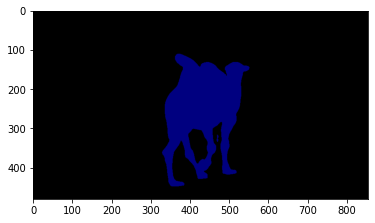

Ground Truth Mask


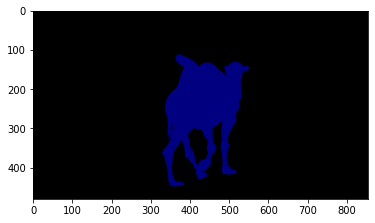

38
Ground Truth Binary Mask


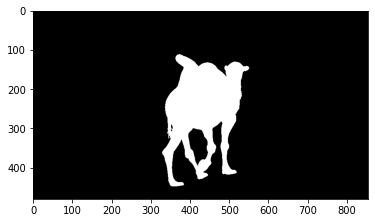

In [5]:
mask_pred_path = '../STCN/out_validation_2017/camel/00063.png'
mask_pred = cv2.imread(mask_pred_path)
print("Predicted Mask")
plt.imshow(mask_pred)
plt.show()
mask_pred_gray = cv2.cvtColor(mask_pred, cv2.COLOR_BGR2GRAY)


gt_matk_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/camel/00063.png'
gt_mask = cv2.imread(gt_matk_path)
print("Ground Truth Mask")
plt.imshow(gt_mask)
plt.show()

gt_mask_gray = cv2.cvtColor(gt_mask, cv2.COLOR_BGR2GRAY)
gt_mask_bin = gt_mask_gray.astype(np.bool)
print(gt_mask_gray[200,400])
print("Ground Truth Binary Mask")
plt.imshow(gt_mask_gray,cmap="gray")
plt.show()

# Something-Something Dataset

Videos were initially in a webm format. They have been sampled on frames using FFMPEG with the same sampling rates as the one used for the provided annotations. For the stake of simplicity, the sampling have been done outside this notebook to avoid importing videos but directly the corresponding frames instead.

Notice only a subset of 3000 videos have been used for reasons of memory available but the results obtained on this subset are already informative.

In [6]:
#Come back to the working directory
os.chdir('..')

Annotations for the Something-Something dataset are bounding-boxes coordinates and have been provided in heavy json files. To avoid any RAM issue, we split the reading of the annotations in two times.

In [7]:
import json

root_path_bounding_box = '../input/bounding-box-something/'

with open(root_path_bounding_box+'bounding_box_smthsmth_part1.json', 'r') as f:
        annotations_1 = json.load(f)
        
with open(root_path_bounding_box+'bounding_box_smthsmth_part2.json', 'r') as f:
        annotations_2 = json.load(f)
        

Insight of the content of the annotations 

In [8]:
annotations_1['2'][0]

{'name': '2/0001.jpg',
 'labels': [{'box2d': {'x1': 97.64950730138266,
    'x2': 427,
    'y1': 11.889318166856967,
    'y2': 239.92858832368972},
   'category': 'pillow',
   'gt_annotation': 'object 0',
   'standard_category': '0000'},
  {'box2d': {'x1': 210.1160330781122,
    'x2': 345.4329005999551,
    'y1': 78.65516045335991,
    'y2': 209.68758889799403},
   'category': 'hand',
   'gt_annotation': 'object hand',
   'standard_category': 'hand'}],
 'gt_placeholders': ['pillow'],
 'nr_instances': 2}

Create some directories to store the next inferred segmentations

In [9]:
out_annotations_path = 'something_something/Annotations/'
os.makedirs(out_annotations_path, exist_ok=True)

out_vid_path_jpg = 'something_something/JPEGImages/'
os.makedirs(out_vid_path_jpg, exist_ok=True)

out_annotations_1st_frame_path = 'something_something_1st_frame/Annotations/'
os.makedirs(out_annotations_1st_frame_path, exist_ok=True)

out_vid_path_jpg_1st_frame = 'something_something_1st_frame/JPEGImages/'
os.makedirs(out_vid_path_jpg_1st_frame, exist_ok=True)

Create the masks for Something-Something dataset using the bounding-box coordinates.

In [10]:
#Define several colors to distinguish one mask per object
COLORS = [(255, 64, 64), (0, 0, 255), (127, 255, 0), (255, 97, 3), (220, 20, 60),
          (255, 185, 15), (255, 20, 147), (255, 105, 180), (60, 179, 113)]


def assign_mapping_to_objects(annotations, video):
    '''
    Assign an index to each object of a video. The objective is to track objects along the video, 
    even if new objects appear during the video.
    
    Inputs :
    annotations (dict) : annotations file
    video (str) : name of the video for which we want to assign an index to its objects
    
    Return:
    dict_color (dict) whose keys are the classes of the objects of a video and values are the index associated. 
    
    '''
    dict_color = {}
    i = 0
    for file in annotations[video]:
        for lab in file['labels']:
            category = lab['category']
            if category not in list(dict_color.keys()):
                dict_color[category] = i
                i+=1
    return dict_color


def annotate_video(file, dict_object2color, root_frame_path):
    '''
    Create a mask corresponding to a video
    
    Inputs :
    file (str) : frame to annotate
    dict_object2color (dict) : dictionnary containing the mapping object/color of a given video
    frame_path (str) : path to get the frames of a given video
    '''
    file_name = file['name']  
    video_name, frame_name = file_name.split('/')
    frame_path = os.path.join(root_frame_path,video_name,'00'+frame_name)


    image = Image.open(frame_path)  
    img_size = image.size
    image = np.array(image, dtype=np.uint8)  
    
    #Consider only the images of size (455, 256). Otherwise there is a problem of alignment with the coordinates of the bounding-boxes.
    if img_size == (455, 256) :
        image = cv2.resize(image, (427, 240))
        #Also save the original image resized so that annotated videos are filtered
        image_original = Image.fromarray(image) 
        os.makedirs(os.path.join(out_vid_path_jpg, video_name), exist_ok=True)
        image_original.save(os.path.join(out_vid_path_jpg, file_name))
        
        os.makedirs(os.path.join(out_vid_path_jpg_1st_frame, video_name), exist_ok=True)
        image_original.save(os.path.join(out_vid_path_jpg_1st_frame, file_name))
    else :
        return
    
    image = np.zeros([image.shape[0],image.shape[1],3])
    image = np.array(image, dtype=np.uint8)
    if file['labels']:        
        for k,i in enumerate(file['labels']):
            category = i['category']
            x1, x2, y1, y2 = i['box2d']['x1'], i['box2d']['x2'], i['box2d']['y1'], i['box2d']['y2']
            color_index = dict_object2color[category]
            color_mask =  COLORS[color_index]
            image = cv2.rectangle(image, tuple([int(x1), int(y1)]), tuple([int(x2), int(y2)]), color_mask, -1)        
          
    
    im = Image.fromarray(image)    

    #Only show the first frame of each video
    if frame_name.endswith('0001.jpg'):
        #if only save first mask
        os.makedirs(os.path.join(out_annotations_1st_frame_path, video_name), exist_ok=True)
        #Convert to PNG
        file_name = file_name[:-3]
        file_name = file_name+'png'
        im.save(os.path.join(out_annotations_1st_frame_path, file_name))
        
    #Save all the masks (for ground truth annotations)
    else :        
        os.makedirs(os.path.join(out_annotations_path, video_name), exist_ok=True)
        #Convert to PNG
        file_name = file_name[:-3]
        file_name = file_name+'png'
        im.save(os.path.join(out_annotations_path, file_name))


In [11]:
list_annotations_file = [annotations_1, annotations_2]
root_frame_path = '../input/videossomething/20bn-something-something-v2-frames'

def annotate_something(list_annotations_file, root_frame_path):
    '''
    Annotate the videos of the Something-Something dataset for which we have annotations
    list_annotations_file (list) : stored annotations
    root_frame_path (str) : path of the frames of the Something-Something dataset
    '''
    list_videos_available = []
    for dir in os.listdir(root_frame_path):
        list_videos_available.append(dir)
        
    for annotations in list_annotations_file:
        for video in annotations :
            if video in list_videos_available :
                dict_object2color = assign_mapping_to_objects(annotations, video)
                for file in annotations[video]:
                    annotate_video(file, dict_object2color, root_frame_path)
                    
annotate_something(list_annotations_file, root_frame_path)

Now we have annotated the dataset with the annotations available, we can free some RAM, get the remaining annotations and annotate the remaining videos of the Something dataset.

In [12]:
import gc
import psutil

del annotations_1
del annotations_2    
del list_annotations_file

gc.collect()

46

In [13]:
root_path_bounding_box = '../input/bounding-box-something/'


with open(root_path_bounding_box+'bounding_box_smthsmth_part3.json', 'r') as f:
        annotations_3 = json.load(f)
        
with open(root_path_bounding_box+'bounding_box_smthsmth_part4.json', 'r') as f:
        annotations_4 = json.load(f)
        
list_annotations_file = [annotations_3, annotations_4]
annotate_something(list_annotations_file, root_frame_path)

del annotations_3
del annotations_4    
del list_annotations_file

gc.collect()

0

# Apply STCN on Something dataset

Since the dataset on whcih we apply STCN is not DAVIS, we use the file eval_generic.py

In [14]:
os.chdir('STCN')
!python eval_generic.py --data_path '../../input/somethingmaskfirstframe' --output 'output-something-annotated-with-first-frame' --model '../../input/loadingsstcn/stcn.pth'
#!python eval_generic.py --data_path '../something_something_1st_frame' --output 'output-something-annotated-with-first-frame' --model '../../input/loadingsstcn/stcn.pth'

Begin progression
  0% (0 of 115) |                        | Elapsed Time: 0:00:00 ETA:  --:--:--Processing 1003 ...
frames_with_gt [0]
passed through frame enumeration 0
13.88834626500011
  0% (1 of 115) |                        | Elapsed Time: 0:00:14 ETA:   0:27:57Processing 1016 ...
frames_with_gt [0]
passed through frame enumeration 0
2.596076861000256
  1% (2 of 115) |                        | Elapsed Time: 0:00:17 ETA:   0:05:48Processing 1017 ...
frames_with_gt [0]
passed through frame enumeration 0
7.300256722000086
  2% (3 of 115) |                        | Elapsed Time: 0:00:26 ETA:   0:15:22Processing 1069 ...
frames_with_gt [0]
passed through frame enumeration 0
10.870002553000177
  3% (4 of 115) |                        | Elapsed Time: 0:00:37 ETA:   0:21:58Processing 1109 ...
frames_with_gt [0]
passed through frame enumeration 0
4.703749754
  4% (5 of 115) |#                       | Elapsed Time: 0:00:43 ETA:   0:09:58Processing 1121 ...
frames_with_gt [0]
passed through

### Compute metrics for the generated segmentation

In the report, we explain how STCN has trouble to distinguish object when the first frame annotation is bounding boxes which implies the impossibility to measure the performance of the segmentation considering each object individually. Instead, we consider each frame as an individual binary mask and compute the Jaccard index (F and J&F make no sense here because ground-truth frames are annotated with bounding-boxes).

In [15]:
def true_positive(mask_gt,mask_pred):
    #Masks need to have the same shape
    assert mask_gt.shape==mask_pred.shape
    tp = np.sum(mask_gt & mask_pred)
    return tp

def false_positive(mask_gt,mask_pred):
    assert mask_gt.shape==mask_pred.shape
    fp = np.sum(np.logical_and(mask_pred == 1, mask_gt == 0))  
    return fp

def false_negative(mask_gt,mask_pred):
    assert mask_gt.shape==mask_pred.shape
    fn = np.sum(np.logical_and(mask_pred == 0, mask_gt == 1))
    return fn

def Jaccard(tp,fp,fn):
    return tp/(tp + fn + fp)

def F_score(tp,fp,fn):
    return (2*tp)/(2*tp + fn + fp)

In [16]:
def compute_scores(data_dir_gt_mask, data_dir_pred_segmentation, list_classes, verbose=True):
    list_jaccard, list_f_score, list_j_and_f = [], [], []
    for dir in os.listdir(data_dir_pred_segmentation):
        if dir in list_classes :        
            jaccard, f_score, j_and_f, n_img = 0,0,0,0        
            for file in sorted(os.listdir(os.path.join(data_dir_pred_segmentation,dir))):
                n_img+=1
                #Open the Ground Truth mask
                mask_gt = cv2.imread(os.path.join(data_dir_gt_mask,dir,file))         
                mask_gt_gray = cv2.cvtColor(mask_gt, cv2.COLOR_RGB2GRAY)
                #Transform masks into binary masks
                gt_mask_bin = mask_gt_gray.astype(np.bool)

                #Open the Predicted mask
                mask_pred = cv2.imread(os.path.join(data_dir_pred_segmentation,dir,file))
                mask_pred_gray = cv2.cvtColor(mask_pred, cv2.COLOR_RGB2GRAY)
                mask_pred_bin = mask_pred_gray.astype(np.bool)

                #Evaluate the metrics
                tp = true_positive(gt_mask_bin,mask_pred_bin)
                fp = false_positive(gt_mask_bin,mask_pred_bin)
                fn = false_negative(gt_mask_bin,mask_pred_bin)

                #Increment the score on the whole video
                j = Jaccard(tp,fp,fn)
                f = F_score(tp,fp,fn)
                jaccard += j
                f_score += f
                j_and_f += (j+f)/2

                
            #Compute the mean score over the sequence of frames 
            jaccard /= n_img
            f_score /= n_img
            j_and_f /= n_img
            if verbose:
                print(f'Jaccard for category {dir} : {jaccard :.2f}')
                print(f'F-score for category {dir} : {f_score :.2f}')
                print(f'J&F for category {dir} : {j_and_f :.2f}')
                print('\n')

            list_jaccard.append(jaccard)
            list_f_score.append(f_score)
            list_j_and_f.append(j_and_f)
    return list_jaccard, list_f_score, list_j_and_f
                                    

In [17]:
list_classes_something = []
for video in os.listdir('output-something-annotated-with-first-frame'):
    list_classes_something.append(video)

In [18]:
data_dir_gt_mask = '../../input/something-annotated/Annotations'
data_dir_pred_segmentation = 'output-something-annotated-with-first-frame'

list_jaccard_something, _, _= compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes_something, verbose=True)
print(f'Mean Jaccard on Somethins-Something dataset : {np.mean(list_jaccard_something):.2f}')

Jaccard for category 2925 : 0.43
F-score for category 2925 : 0.58
J&F for category 2925 : 0.50


Jaccard for category 3059 : 0.92
F-score for category 3059 : 0.96
J&F for category 3059 : 0.94


Jaccard for category 2216 : 0.92
F-score for category 2216 : 0.96
J&F for category 2216 : 0.94


Jaccard for category 1553 : 0.84
F-score for category 1553 : 0.91
J&F for category 1553 : 0.87


Jaccard for category 3197 : 0.57
F-score for category 3197 : 0.67
J&F for category 3197 : 0.62


Jaccard for category 1513 : 0.57
F-score for category 1513 : 0.64
J&F for category 1513 : 0.60


Jaccard for category 2860 : 0.78
F-score for category 2860 : 0.87
J&F for category 2860 : 0.82


Jaccard for category 23 : 0.91
F-score for category 23 : 0.95
J&F for category 23 : 0.93


Jaccard for category 2709 : 0.41
F-score for category 2709 : 0.57
J&F for category 2709 : 0.49


Jaccard for category 2462 : 0.66
F-score for category 2462 : 0.79
J&F for category 2462 : 0.72


Jaccard for category 338 : 0.58
F-sc

# Pre-trained model Mask-RCNN

Getting a proper manual annotation of the first frame of a video requires a human to spend some time on this fastidious
task. This also prevents the development of a real time solution based on STCN and generally limits its scope of application to
a tiny portion of the videos available. To overcome this limitation, we’ve tried to combine STCN with automated image segmentation approaches (Mask-RCNN and PointRend) and evaluated the results.

### Imports 

In [19]:
os.chdir('..')

In [20]:
!pip install pyyaml==5.1
# clone the repo in order to access pre-defined configs in PointRend project
!git clone --branch v0.6 https://github.com/facebookresearch/detectron2.git detectron2_repo
# install detectron2 from source
!pip install -e detectron2_repo

os.chdir('detectron2_repo')

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
coco_metadata = MetadataCatalog.get("coco_2017_val")

# import PointRend project
from detectron2.projects import point_rend

     |████████████████████████████████| 274 kB 536 kB/s            
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=59b0eacd4519ca95e29f268848e0bd26f6c07699cbe9556a87e426cf0bb08bdd
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask-cudf 21.10.1 requires cupy-cuda114, which is not installed.
libcst 0.3.21 requires pyyaml>=5.2, but you have pyyaml 5.1 which is incompatible.
kubernetes 19.15.0 requires pyyaml>=5.4.1, but you have pyyaml 5.1 which is incompatible.
featuretools 1.2.0 requires pyyaml>=5.4,

Example of mask segmentation obtained using Mask-RCNN

Original image


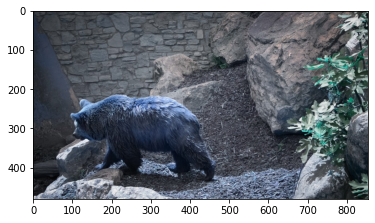

model_final_f10217.pkl: 178MB [00:09, 18.5MB/s]                              
/opt/conda/lib/python3.7/site-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /usr/local/src/pytorch/aten/src/ATen/native/BinaryOps.cpp:461.)
  return torch.floor_divide(self, other)


Mask-RCNN


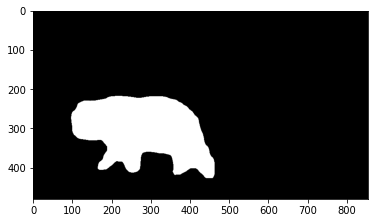

model_final_edd263.pkl: 241MB [00:12, 18.9MB/s]                              


WARNING [01/25 19:19:36 d2.projects.point_rend.mask_head]: Weight format of PointRend models have changed! Applying automatic conversion now ...
PointRend


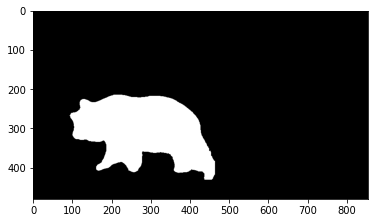

In [21]:
im = cv2.imread("../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p/bear/00000.jpg")
print('Original image')
plt.imshow(im)
plt.show()

#Mask-RCNN
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
mask_rcnn_predictor = DefaultPredictor(cfg)
mask_rcnn_outputs = mask_rcnn_predictor(im)
mask_rcnn_np = mask_rcnn_outputs['instances'].pred_masks.cpu().numpy()
print('Mask-RCNN')
plt.imshow(mask_rcnn_np[0],cmap='gray')
plt.show()


#PointRend
# Add PointRend-specific config
point_rend.add_pointrend_config(cfg)
# Load a config from file
cfg.merge_from_file("projects/PointRend/configs/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco.yaml")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Use a model from PointRend model zoo: https://github.com/facebookresearch/detectron2/tree/master/projects/PointRend#pretrained-models
cfg.MODEL.WEIGHTS = "detectron2://PointRend/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco/164955410/model_final_edd263.pkl"
predictor_pointrend = DefaultPredictor(cfg)
pointrend_outputs = predictor_pointrend(im)
mask_pointrend_np=pointrend_outputs['instances'].pred_masks.cpu().numpy()
print("PointRend")
plt.imshow(mask_pointrend_np[0],cmap='gray')
plt.show()

In [22]:
def get_surface_object(mask_bin):
    surface = np.sum(mask_bin)/mask_bin.size*100
    return surface

In [23]:
def segment_first_frame(jpg_first_frame_path, output_path, score_threshold, surface_threshold, method='mask-RCNN'):
    try :
        cfg = get_cfg()
        if method=='mask-RCNN':
            cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
            cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
            cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
            predictor = DefaultPredictor(cfg)

        elif method=='PointRend':
            point_rend.add_pointrend_config(cfg)
            cfg.merge_from_file("projects/PointRend/configs/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco.yaml")
            cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
            # Use a model from PointRend model zoo: https://github.com/facebookresearch/detectron2/tree/master/projects/PointRend#pretrained-models
            cfg.MODEL.WEIGHTS = "detectron2://PointRend/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco/164955410/model_final_edd263.pkl"
            predictor = DefaultPredictor(cfg)

        for video in sorted(os.listdir(jpg_first_frame_path)):
            first_frame = os.path.join(jpg_first_frame_path, video,'00000.jpg')
            im = cv2.imread(first_frame)  

            pred_segmentation = predictor(im)
            if len(pred_segmentation['instances'].pred_masks.cpu().numpy())>0 :
                mask_bin = np.zeros((im.shape[0], im.shape[1]))
                #mask_col = mask_bin
                mask_bin = mask_bin.astype(np.bool)
                max_surface = 0            
                for i in range(len(pred_segmentation['instances'])):
                    surface_mask = get_surface_object(pred_segmentation['instances'].pred_masks.cpu().numpy()[i])
                    if surface_mask>max_surface:
                        max_surface = surface_mask
                        idx_max_surface = i
                    if pred_segmentation['instances'].scores.cpu().numpy()[i]>score_threshold and surface_mask>surface_threshold: 
                        mask_bin_i = pred_segmentation['instances'].pred_masks.cpu().numpy()[i]
                        mask_bin = (mask_bin_i | mask_bin)

                if np.sum(mask_bin)==0:
                    mask_bin = pred_segmentation['instances'].pred_masks.cpu().numpy()[idx_max_surface]


                #Saving
                os.makedirs(os.path.join(output_path,video),exist_ok=True)            
                mask_bin = Image.fromarray(mask_bin) 
                mask_bin.save(os.path.join(output_path,video,'00000.png'))
    except :
        'Error : Choose a method between mask-RCNN or PointRend'

Tuning the best (threshold_score, threshold_surface) hyperparameters

In [24]:
def hyperparam_tuning(list_threshold_score, list_threshold_surface, method):    

    jpg_first_frame_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p'
    output_path = '../auto_segmentation_1st_frame'
    os.makedirs(output_path, exist_ok=True)  

    data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/'
    data_dir_pred_segmentation = '../auto_segmentation_1st_frame'

    matrix_JF = np.zeros((len(list_threshold_score),len(list_threshold_surface)))

    for i,threshold_score in enumerate(list_threshold_score):
        for j,threshold_surface in enumerate(list_threshold_surface):
            segment_first_frame(jpg_first_frame_path, output_path, threshold_score, threshold_surface, method=method)
            list_classes = []
            for video in os.listdir('../auto_segmentation_1st_frame'):
                list_classes.append(video)
            _, _, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes, verbose=False)
            print(f'With a threshold_score : {threshold_score} and threshold_surface : {threshold_surface}, we obtain a J&F index of {np.mean(list_j_and_f_davis) :.2f} on the training set')
            matrix_JF[i,j] = np.round(np.mean(list_j_and_f_davis),2)
            
    #Keep the best params
    idx_max = np.unravel_index(np.argmax(matrix_JF), matrix_JF.shape)
    best_threshold_score = list_threshold_score[idx_max[0]]
    best_threshold_surface = list_threshold_surface[idx_max[1]]

    return best_threshold_score, best_threshold_surface

In [25]:
list_threshold_score = [0.8,0.9,0.95,0.99]
list_threshold_surface = [0.5,1,2]

best_threshold_score_RCNN, best_threshold_surface_RCNN = hyperparam_tuning(list_threshold_score, list_threshold_surface, 'mask-RCNN')
best_threshold_score_PointRend, best_threshold_surface_PointRend = hyperparam_tuning(list_threshold_score, list_threshold_surface, 'PointRend')

With a threshold_score : 0.8 and threshold_surface : 0.5, we obtain a J&F index of 0.74 on the training set
With a threshold_score : 0.8 and threshold_surface : 1, we obtain a J&F index of 0.74 on the training set
With a threshold_score : 0.8 and threshold_surface : 2, we obtain a J&F index of 0.73 on the training set
With a threshold_score : 0.9 and threshold_surface : 0.5, we obtain a J&F index of 0.72 on the training set
With a threshold_score : 0.9 and threshold_surface : 1, we obtain a J&F index of 0.73 on the training set
With a threshold_score : 0.9 and threshold_surface : 2, we obtain a J&F index of 0.72 on the training set
With a threshold_score : 0.95 and threshold_surface : 0.5, we obtain a J&F index of 0.73 on the training set
With a threshold_score : 0.95 and threshold_surface : 1, we obtain a J&F index of 0.73 on the training set
With a threshold_score : 0.95 and threshold_surface : 2, we obtain a J&F index of 0.72 on the training set
With a threshold_score : 0.99 and thr

Produce segmentation using the best hyperparameters

In [26]:
jpg_first_frame_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p'
output_path = '../segmentation_1st_frame_MaskRCNN'
os.makedirs(output_path, exist_ok=True)  

data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/'
data_dir_pred_segmentation = '../segmentation_1st_frame_MaskRCNN'

segment_first_frame(jpg_first_frame_path, output_path, best_threshold_score_RCNN, best_threshold_surface_RCNN, method='mask-RCNN')

In [27]:
import shutil

if os.path.isdir('../copydavis_rcnn'):
    shutil.rmtree('../copydavis_rcnn')

#Copy Davis directories
shutil.copytree('../../input/davis480dataset','../copydavis_rcnn')

#Remove the ground-truth annotations from copydavis
list_dir = os.listdir('../copydavis_rcnn/DAVIS_TRAIN/DAVIS/Annotations/480p')
for video in list_dir:
    shutil.rmtree(os.path.join('../copydavis_rcnn/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
    

 
#Convert from 1 channel to 3 channels the segmentation produced by Mask-RCNN and save in tmp directory
for video in os.listdir('../segmentation_1st_frame_MaskRCNN'):
    os.makedirs(os.path.join('tmp',video))
    for frame in os.listdir(os.path.join('../segmentation_1st_frame_MaskRCNN',video)):
        img = Image.open(os.path.join('../segmentation_1st_frame_MaskRCNN',video,frame)).convert('P')
        img.save(os.path.join('tmp',video,frame))
#Copy from tmp to copydavis
for video in os.listdir('tmp'):
    shutil.copytree(os.path.join('tmp', video), os.path.join('../copydavis_rcnn/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
    
#Delete tmp directory    
shutil.rmtree('tmp')
        
os.chdir('../STCN')

#Infer the segmentation of the whole ivdeo from the first frame
!python eval_davis.py --output 'out_validation_2017_MaskRCNN' --davis_path ../copydavis_rcnn/DAVIS_TRAIN/DAVIS/ --model '../../input/loadingsstcn/stcn.pth'

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
100% (30 of 30) |########################| Elapsed Time: 0:02:43 Time:  0:02:43
Total pr

We can't use the evaluation method provided by the authors of DAVIS dataset since it requires to distinguish objects and a mapping from each object its ground-truth equivalent (using the same color for example). Instead, we use our own implementation of J, F and J&F which consider only one binary mask per frame instead of 1 binary mask per object. It necessarily provide higher scores that evaluating each object individually because doesn't take into account some overlapping between objects. We first reevaluate the scores obtained with the manual segmentation in order to be able to compare the different methods.  

In [28]:
list_classes = []
for video in os.listdir('../STCN/out_validation_2017_MaskRCNN'):
            list_classes.append(video)

data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/'
data_dir_pred_segmentation = '../STCN/out_validation_2017'

list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes, verbose=True)

print(f'Mean Jaccard on Davis validation dataset : {np.mean(list_jaccard_davis):.2f}')
print(f'Mean F-score on Davis validation dataset : {np.mean(list_f_score_davis):.2f}')
print(f'Mean J&F on Davis validation dataset: {np.mean(list_j_and_f_davis):.2f}')

Jaccard for category pigs : 0.96
F-score for category pigs : 0.98
J&F for category pigs : 0.97


Jaccard for category judo : 0.95
F-score for category judo : 0.97
J&F for category judo : 0.96


Jaccard for category motocross-jump : 0.93
F-score for category motocross-jump : 0.96
J&F for category motocross-jump : 0.95


Jaccard for category drift-chicane : 0.89
F-score for category drift-chicane : 0.94
J&F for category drift-chicane : 0.91


Jaccard for category dog : 0.96
F-score for category dog : 0.98
J&F for category dog : 0.97


Jaccard for category loading : 0.92
F-score for category loading : 0.96
J&F for category loading : 0.94


Jaccard for category india : 0.92
F-score for category india : 0.96
J&F for category india : 0.94


Jaccard for category dogs-jump : 0.95
F-score for category dogs-jump : 0.98
J&F for category dogs-jump : 0.97


Jaccard for category drift-straight : 0.94
F-score for category drift-straight : 0.97
J&F for category drift-straight : 0.96


Jaccard for cate

In [29]:
data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/'
data_dir_pred_segmentation = '../STCN/out_validation_2017_MaskRCNN'

list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes, verbose=True)

print(f'Mean Jaccard on Davis validation dataset : {np.mean(list_jaccard_davis):.2f}')
print(f'Mean F-score on Davis validation dataset : {np.mean(list_f_score_davis):.2f}')
print(f'Mean J&F on Davis validation dataset: {np.mean(list_j_and_f_davis):.2f}')

Jaccard for category pigs : 0.93
F-score for category pigs : 0.96
J&F for category pigs : 0.95


Jaccard for category judo : 0.56
F-score for category judo : 0.72
J&F for category judo : 0.64


Jaccard for category motocross-jump : 0.30
F-score for category motocross-jump : 0.43
J&F for category motocross-jump : 0.37


Jaccard for category drift-chicane : 0.74
F-score for category drift-chicane : 0.82
J&F for category drift-chicane : 0.78


Jaccard for category dog : 0.91
F-score for category dog : 0.95
J&F for category dog : 0.93


Jaccard for category loading : 0.69
F-score for category loading : 0.81
J&F for category loading : 0.75


Jaccard for category india : 0.55
F-score for category india : 0.69
J&F for category india : 0.62


Jaccard for category dogs-jump : 0.94
F-score for category dogs-jump : 0.97
J&F for category dogs-jump : 0.96


Jaccard for category drift-straight : 0.86
F-score for category drift-straight : 0.92
J&F for category drift-straight : 0.89


Jaccard for cate

In [30]:
data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p'
data_dir_pred_segmentation = '../STCN/out_validation_2017_MaskRCNN'
list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes)
print(f'We obtain a J index of {np.mean(list_jaccard_davis) :.2f}, a F index of {np.mean(list_f_score_davis) :.2f} and a J&F index of {np.mean(list_j_and_f_davis) :.2f} on the training set')
      

Jaccard for category pigs : 0.93
F-score for category pigs : 0.96
J&F for category pigs : 0.95


Jaccard for category judo : 0.56
F-score for category judo : 0.72
J&F for category judo : 0.64


Jaccard for category motocross-jump : 0.30
F-score for category motocross-jump : 0.43
J&F for category motocross-jump : 0.37


Jaccard for category drift-chicane : 0.74
F-score for category drift-chicane : 0.82
J&F for category drift-chicane : 0.78


Jaccard for category dog : 0.91
F-score for category dog : 0.95
J&F for category dog : 0.93


Jaccard for category loading : 0.69
F-score for category loading : 0.81
J&F for category loading : 0.75


Jaccard for category india : 0.55
F-score for category india : 0.69
J&F for category india : 0.62


Jaccard for category dogs-jump : 0.94
F-score for category dogs-jump : 0.97
J&F for category dogs-jump : 0.96


Jaccard for category drift-straight : 0.86
F-score for category drift-straight : 0.92
J&F for category drift-straight : 0.89


Jaccard for cate

In [31]:
os.chdir('../detectron2_repo')
jpg_first_frame_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p'
output_path = '../segmentation_1st_frame_PointRend'
os.makedirs(output_path, exist_ok=True)  

data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p/'
data_dir_pred_segmentation = '../segmentation_1st_frame_PointRend'

#segment_first_frame(jpg_first_frame_path, output_path, 0.95, 0.05, method='PointRend')
segment_first_frame(jpg_first_frame_path, output_path, best_threshold_score_PointRend, best_threshold_surface_PointRend, method='PointRend')

WARNING [01/25 19:30:46 d2.projects.point_rend.mask_head]: Weight format of PointRend models have changed! Applying automatic conversion now ...


In [32]:
#Copy Davis directories
shutil.copytree('../../input/davis480dataset','../copydavis_pointrend')

#Remove the ground-truth annotations from copydavis
list_dir = os.listdir('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p')
for video in list_dir:
    shutil.rmtree(os.path.join('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
    

 
#Convert from 1 channel to 3 channels the segmentation produced by Mask-RCNN and save in tmp directory
for video in os.listdir('../segmentation_1st_frame_PointRend'):
    os.makedirs(os.path.join('temp',video))
    for frame in os.listdir(os.path.join('../segmentation_1st_frame_PointRend',video)):
        img = Image.open(os.path.join('../segmentation_1st_frame_PointRend',video,frame)).convert('P')
        img.save(os.path.join('temp',video,frame))
        
#Copy from tmp to copydavis
for video in os.listdir('temp'):
    shutil.copytree(os.path.join('temp', video), os.path.join('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
        
#Delete tmp directory    
shutil.rmtree('temp')

#Clone STCN and infer the segmentation for the Davis dataset based on PointRend's first frame segmentation
os.chdir('../STCN')
!python eval_davis.py --output 'out_validation_2017_PointRend' --davis_path ../copydavis_pointrend/DAVIS_TRAIN/DAVIS/ --model '../../input/loadingsstcn/stcn.pth'                     

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
100% (30 of 30) |########################| Elapsed Time: 0:02:46 Time:  0:02:46
Total pr

In [33]:
data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p'
data_dir_pred_segmentation = '../STCN/out_validation_2017_PointRend'
list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes)
print(f'We obtain a J index of {np.mean(list_jaccard_davis) :.2f}, a F index of {np.mean(list_f_score_davis) :.2f} and a J&F index of {np.mean(list_j_and_f_davis) :.2f} on the training set')
      

Jaccard for category pigs : 0.58
F-score for category pigs : 0.74
J&F for category pigs : 0.66


Jaccard for category judo : 0.57
F-score for category judo : 0.73
J&F for category judo : 0.65


Jaccard for category motocross-jump : 0.28
F-score for category motocross-jump : 0.41
J&F for category motocross-jump : 0.35


Jaccard for category drift-chicane : 0.89
F-score for category drift-chicane : 0.94
J&F for category drift-chicane : 0.92


Jaccard for category dog : 0.92
F-score for category dog : 0.96
J&F for category dog : 0.94


Jaccard for category loading : 0.80
F-score for category loading : 0.89
J&F for category loading : 0.84


Jaccard for category india : 0.62
F-score for category india : 0.74
J&F for category india : 0.68


Jaccard for category dogs-jump : 0.95
F-score for category dogs-jump : 0.97
J&F for category dogs-jump : 0.96


Jaccard for category drift-straight : 0.94
F-score for category drift-straight : 0.97
J&F for category drift-straight : 0.95


Jaccard for cate

# Use BBox to obtain better segmentation

The objective is to improve the segmentation obtained with Mask-RCNN and PointRend adding some knowledge on the image.
Instead of having no prior knowledge on the first frame, we try to get bounding box of the object from ground_truth first frame images and then apply Mask-RCNN and PointRend. The idea is to reduce the manual work by just requiring bounding-box of the object instead of manual segmentation, which reduces the workload a lot.   

horsejump-high


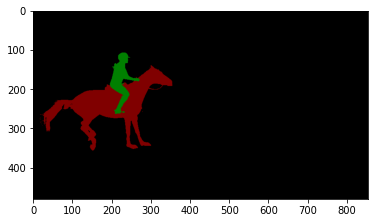

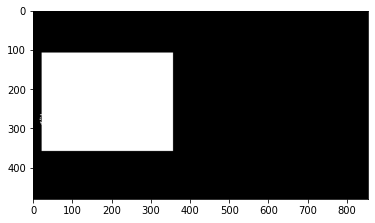

horsejump-low


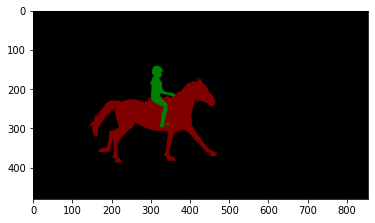

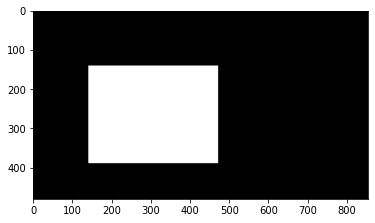

crossing


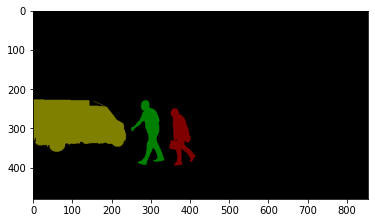

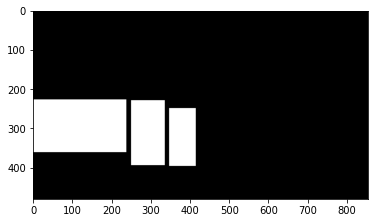

upside-down


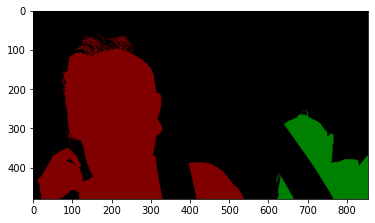

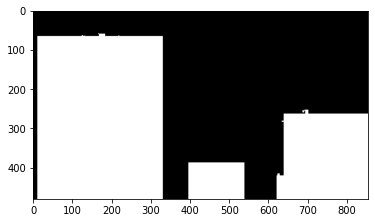

lucia


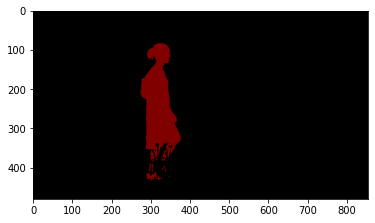

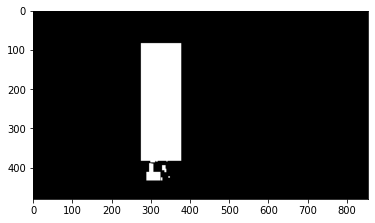

motorbike


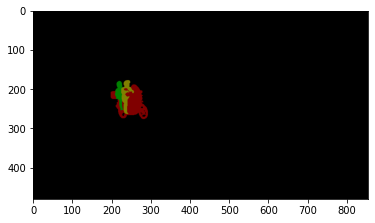

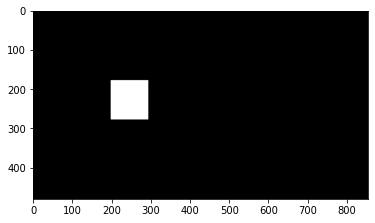

drift-chicane


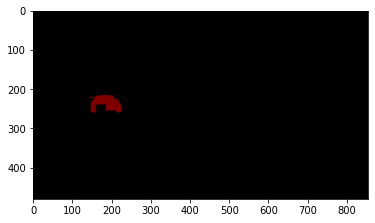

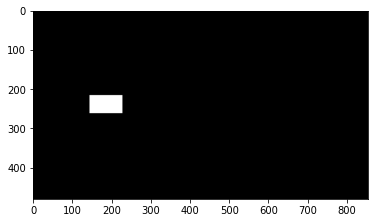

boxing-fisheye


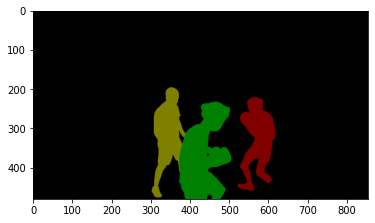

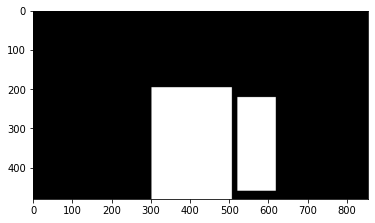

dog-agility


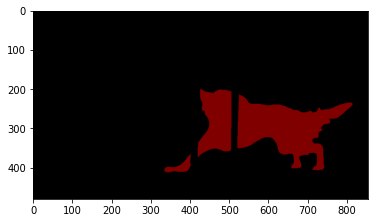

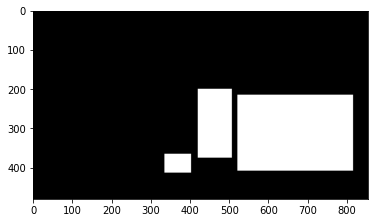

gold-fish


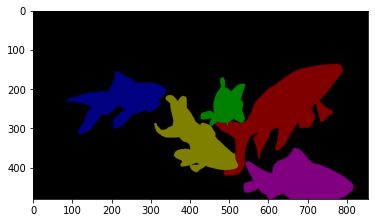

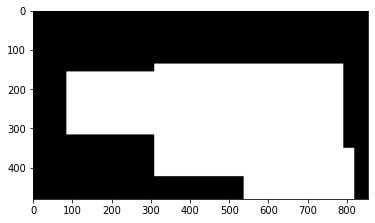

bus


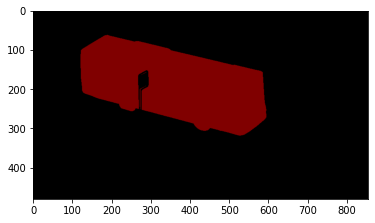

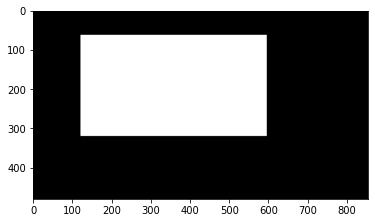

tractor-sand


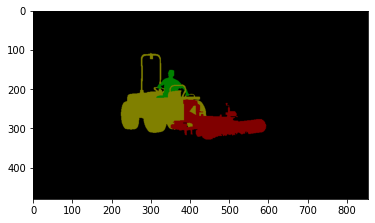

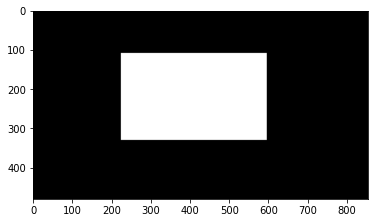

tennis


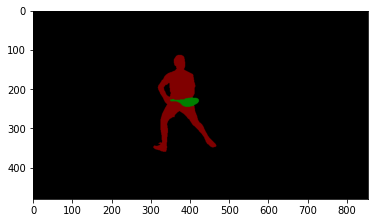

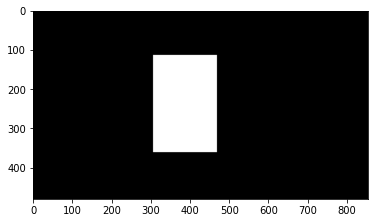

breakdance-flare


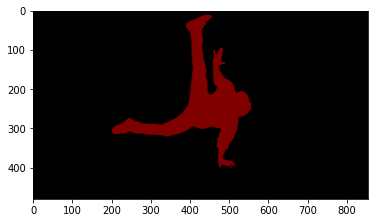

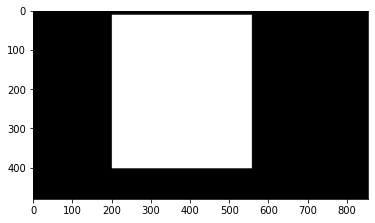

lab-coat


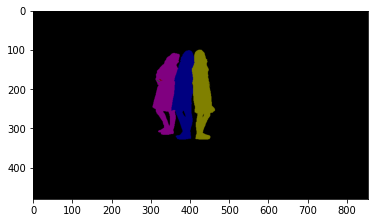

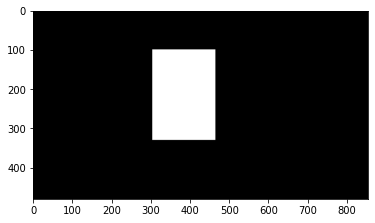

soccerball


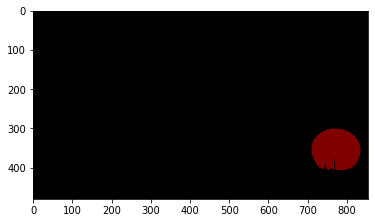

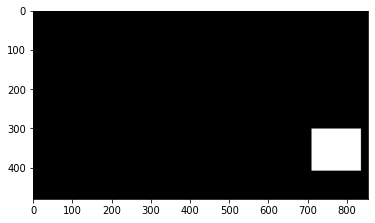

cat-girl


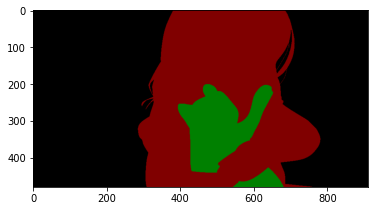

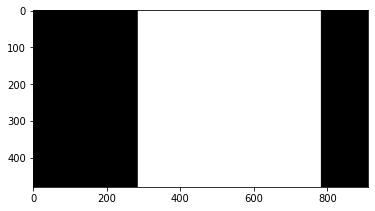

car-turn


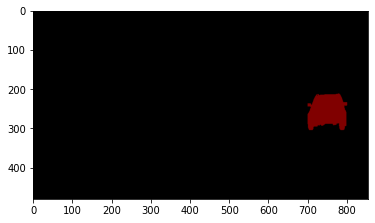

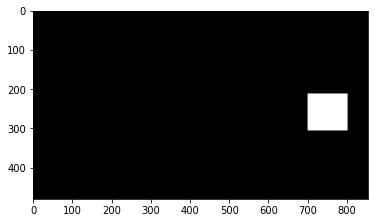

stunt


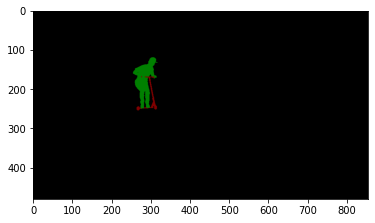

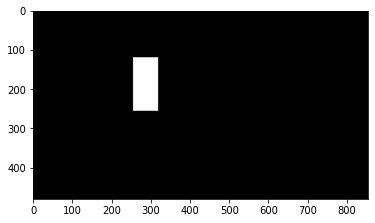

kite-surf


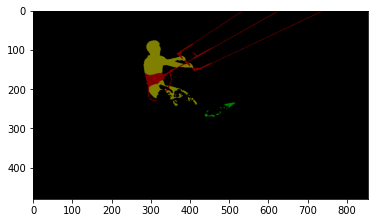

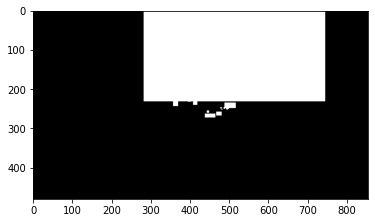

lindy-hop


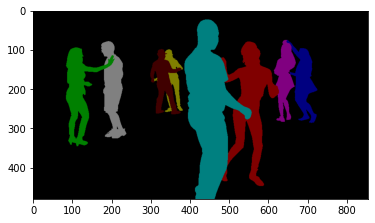

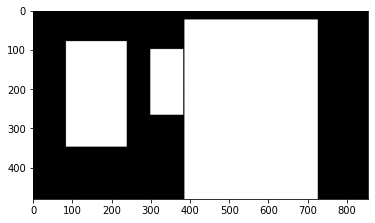

blackswan


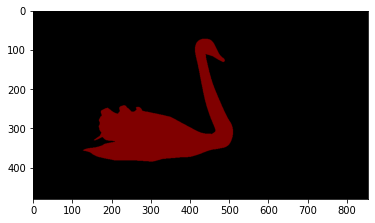

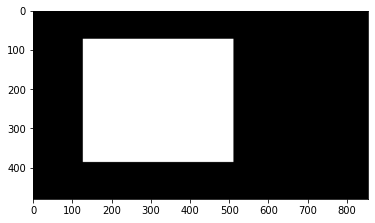

parkour


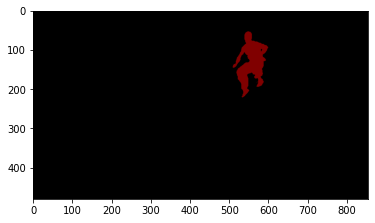

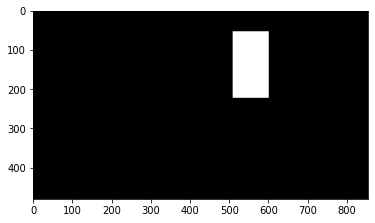

schoolgirls


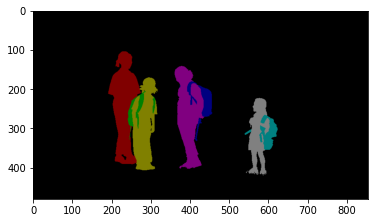

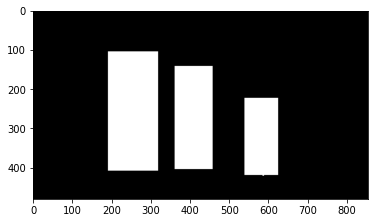

dog


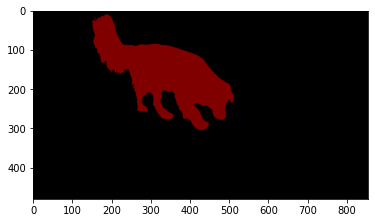

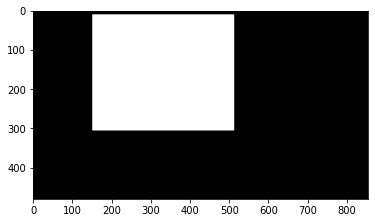

swing


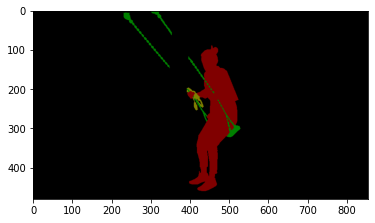

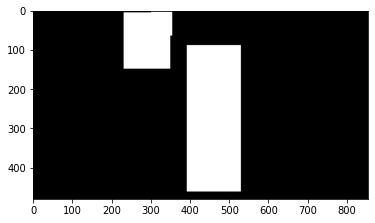

car-roundabout


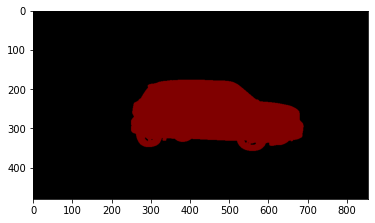

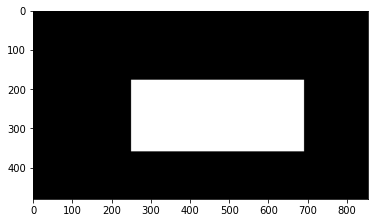

varanus-cage


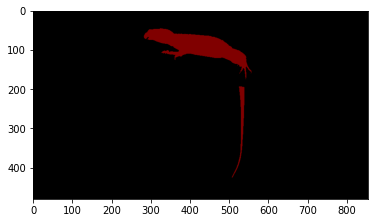

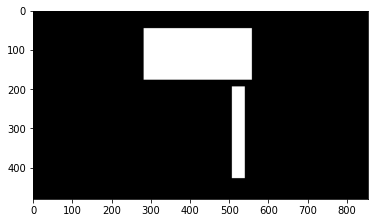

shooting


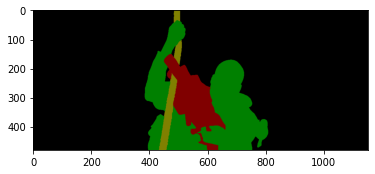

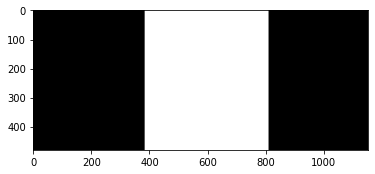

libby


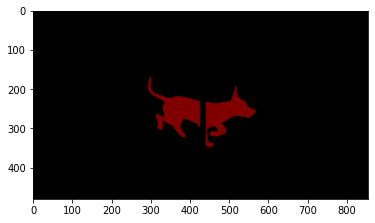

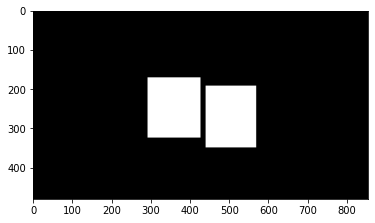

bear


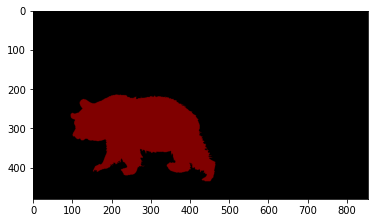

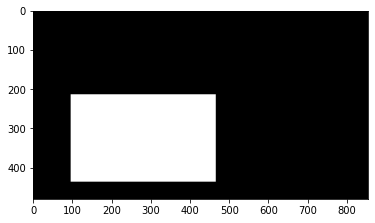

mbike-trick


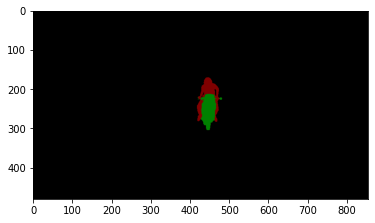

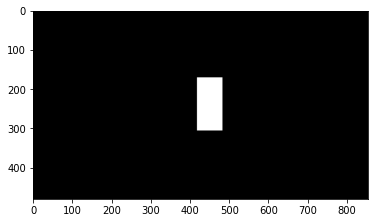

stroller


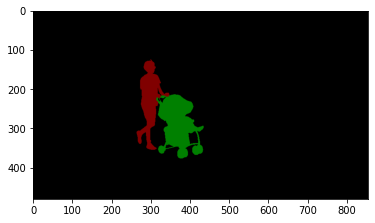

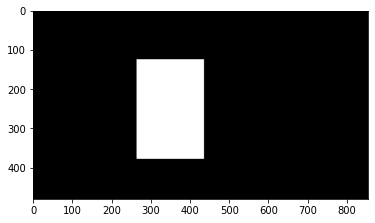

dancing


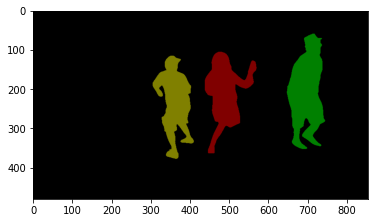

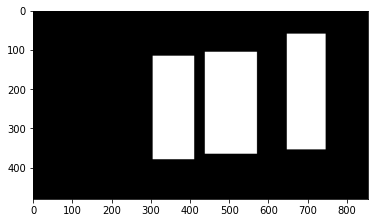

walking


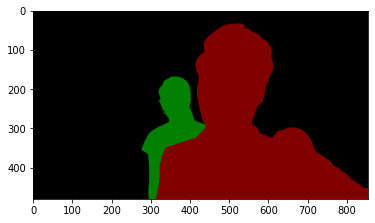

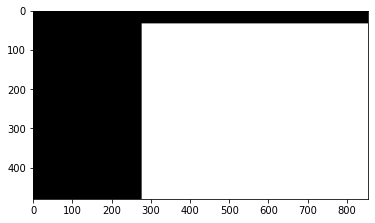

koala


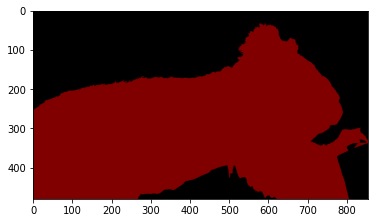

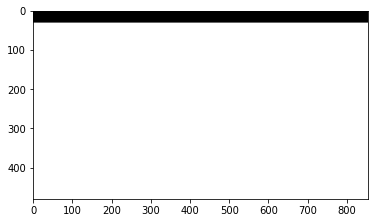

judo


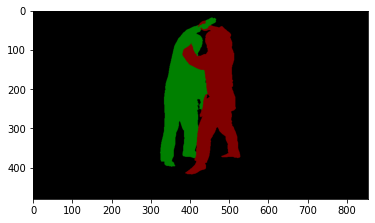

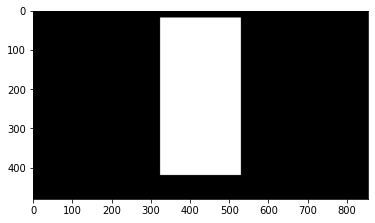

disc-jockey


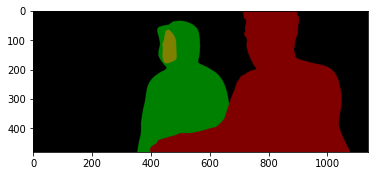

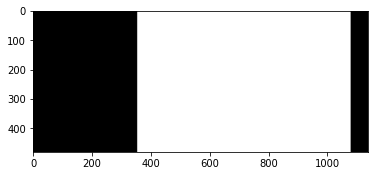

drone


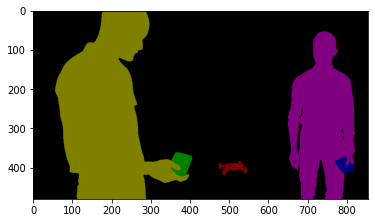

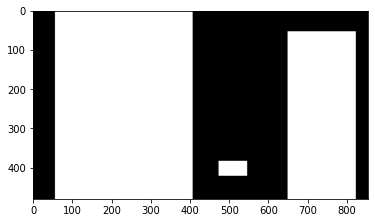

tuk-tuk


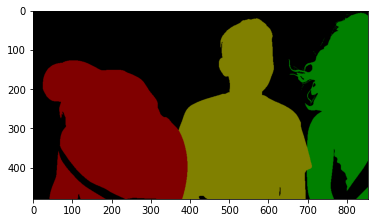

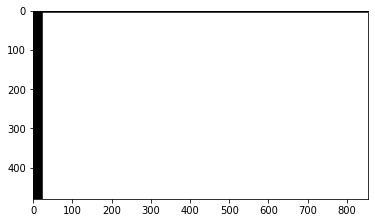

rallye


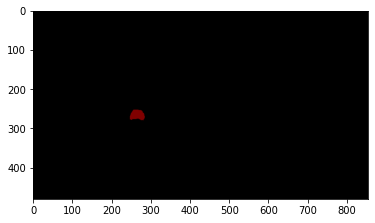

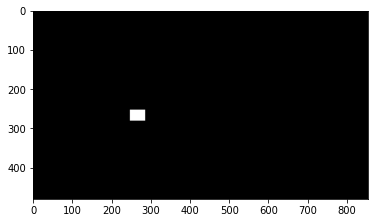

rollerblade


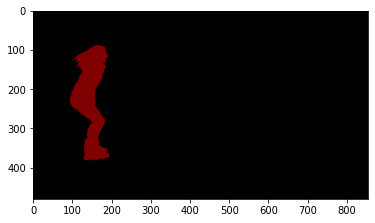

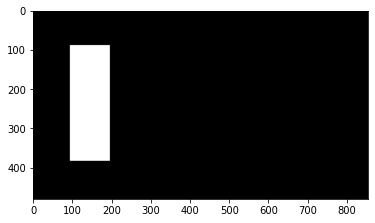

kite-walk


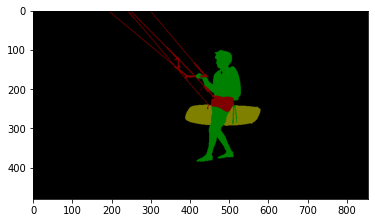

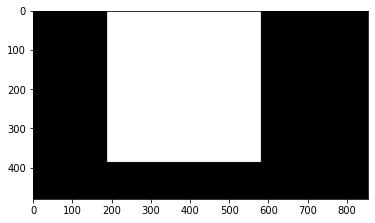

kid-football


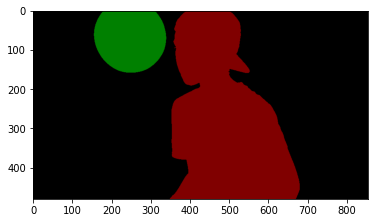

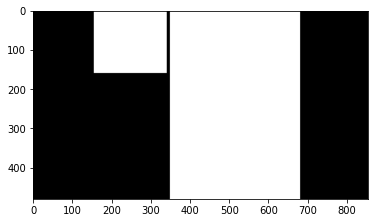

night-race


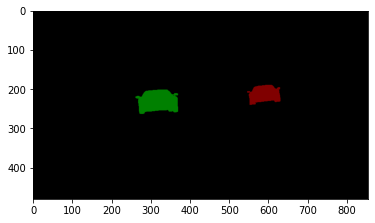

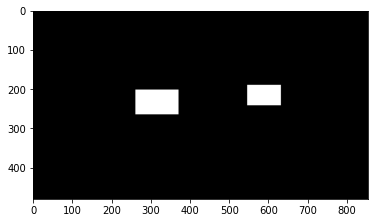

bmx-bumps


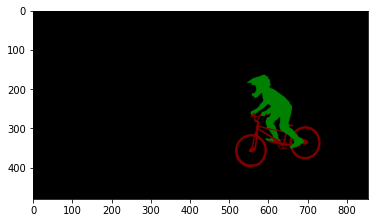

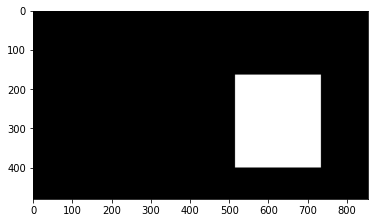

planes-water


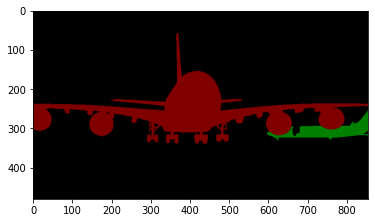

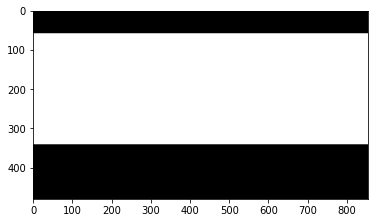

paragliding-launch


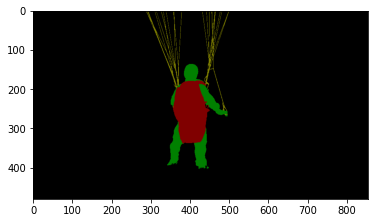

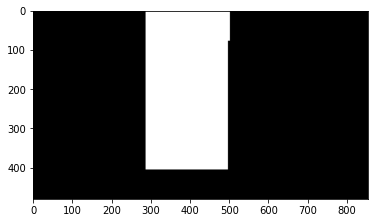

motocross-bumps


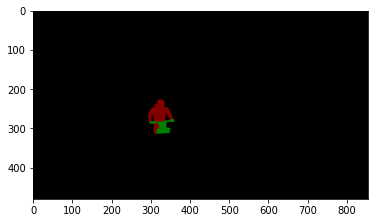

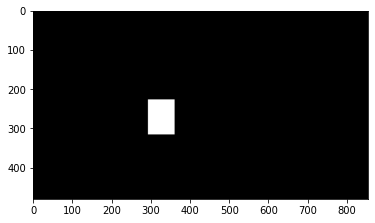

cows


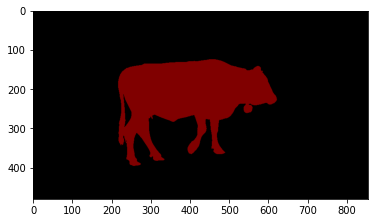

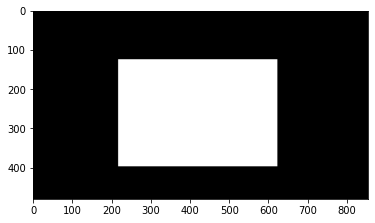

dogs-scale


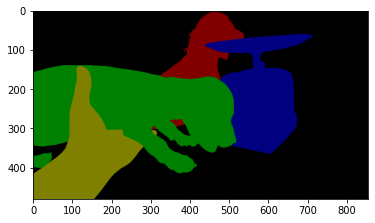

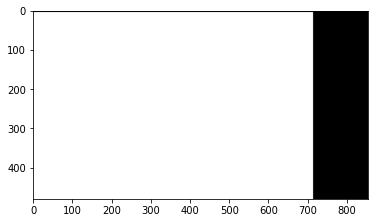

boat


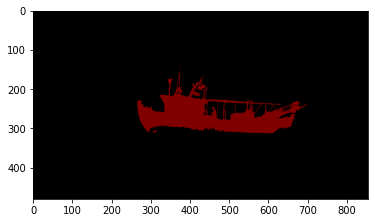

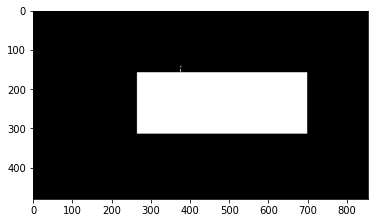

surf


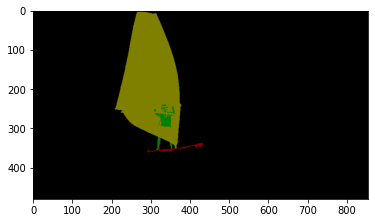

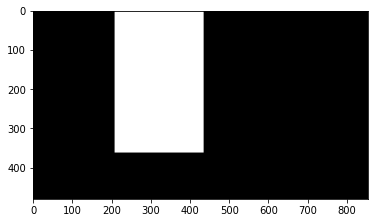

paragliding


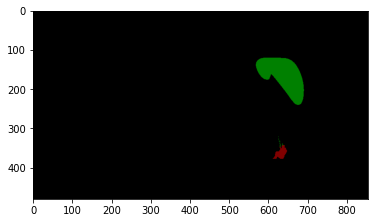

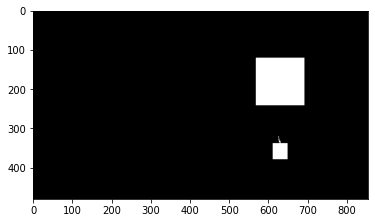

snowboard


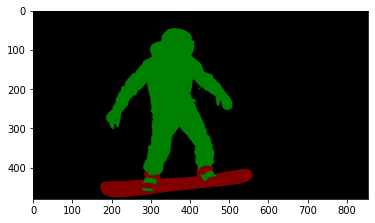

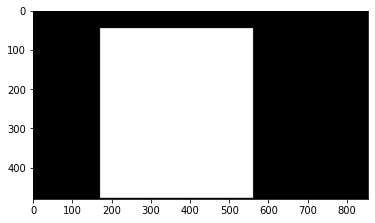

motocross-jump


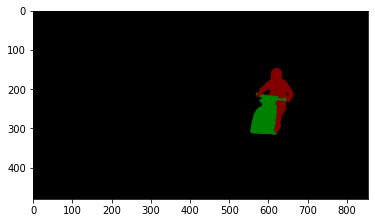

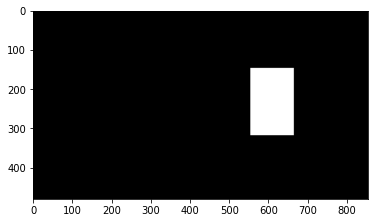

mallard-fly


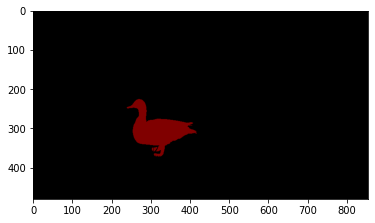

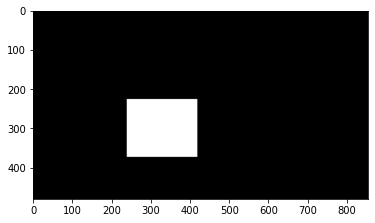

elephant


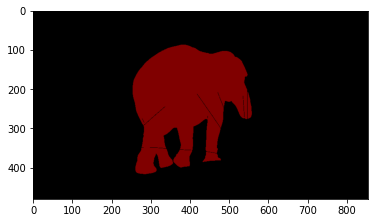

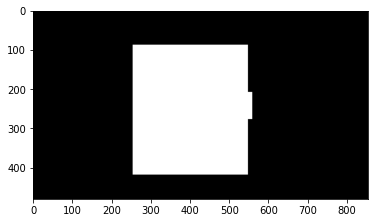

sheep


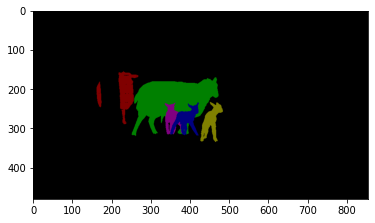

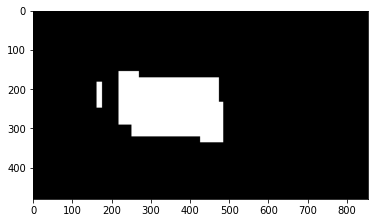

dance-twirl


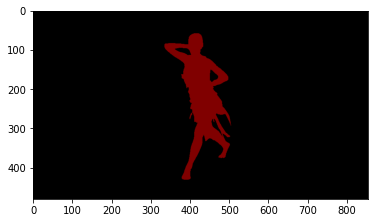

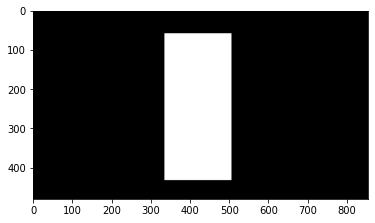

classic-car


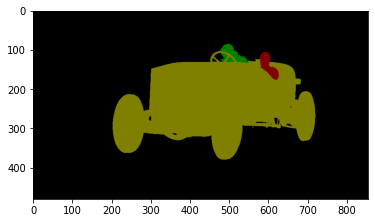

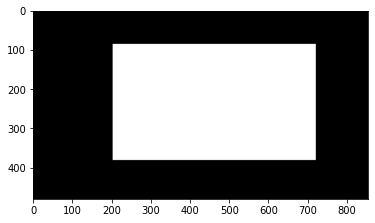

dogs-jump


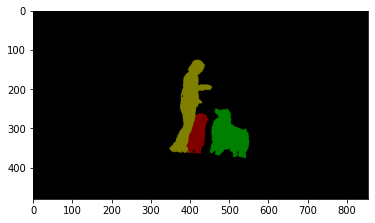

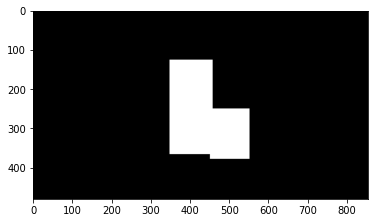

bmx-trees


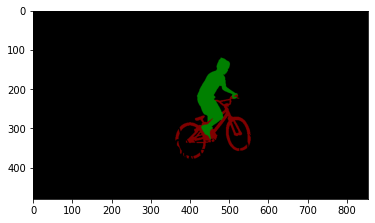

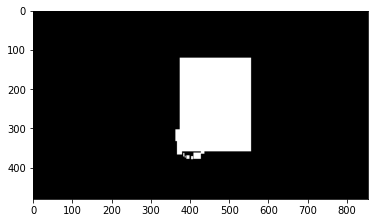

soapbox


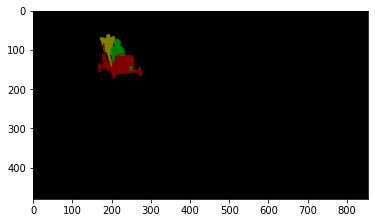

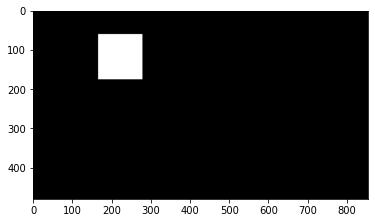

breakdance


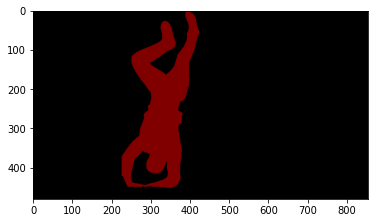

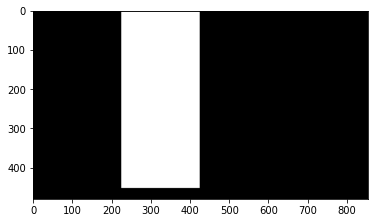

miami-surf


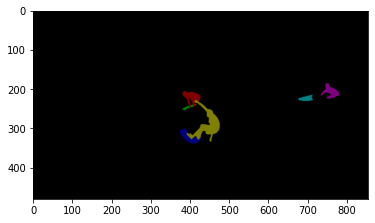

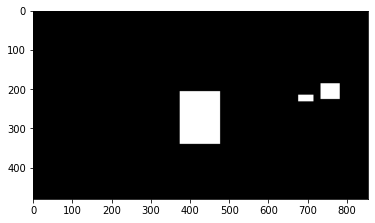

dog-gooses


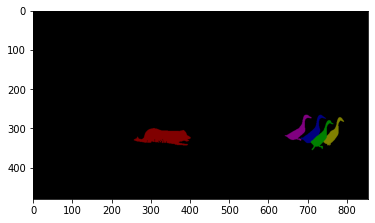

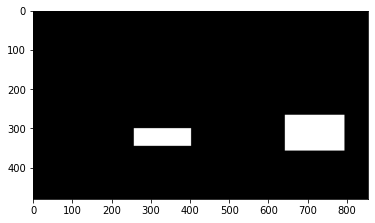

drift-turn


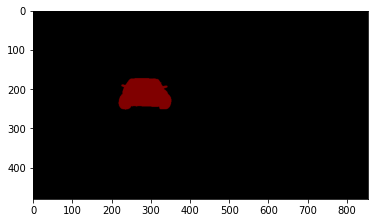

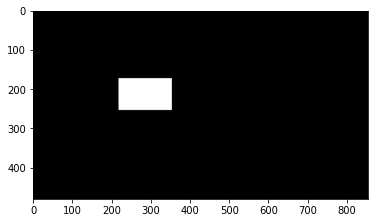

pigs


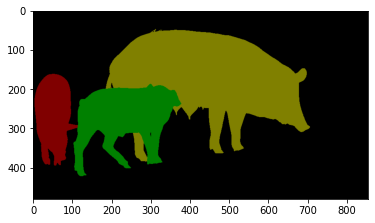

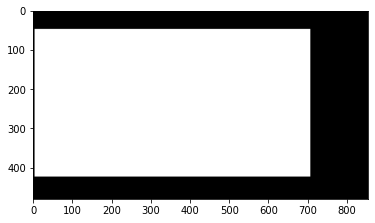

india


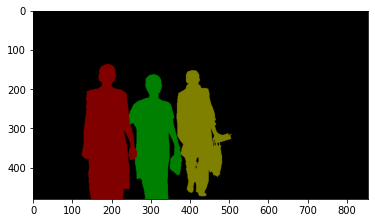

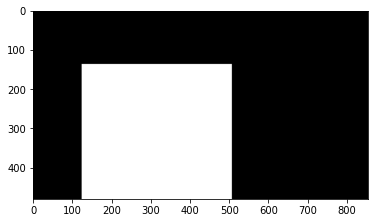

goat


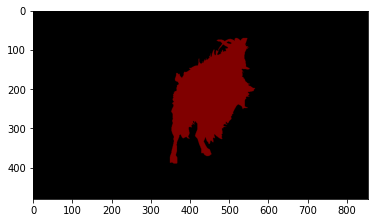

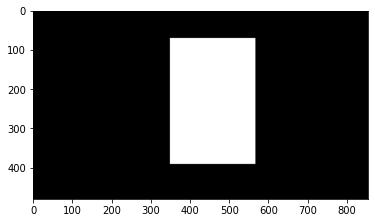

flamingo


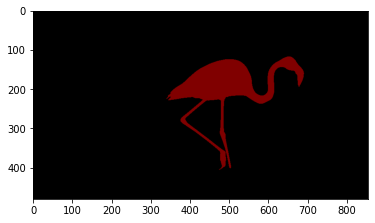

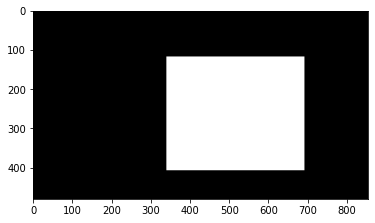

hike


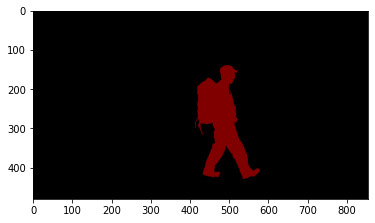

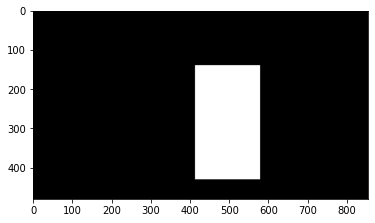

rhino


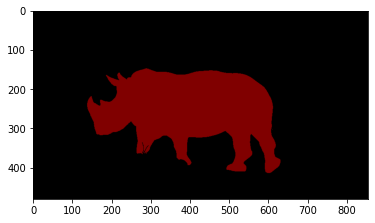

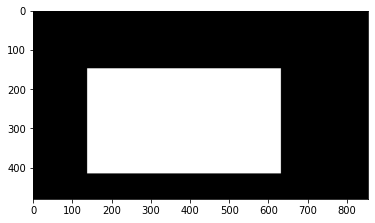

mallard-water


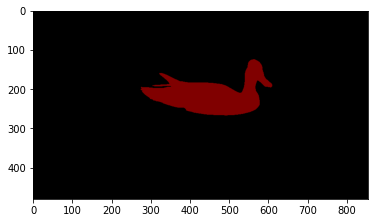

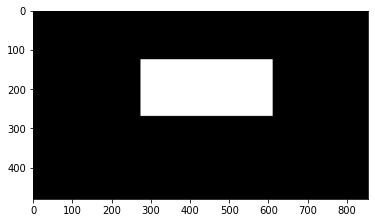

scooter-black


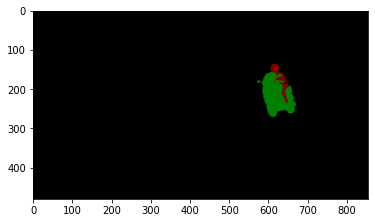

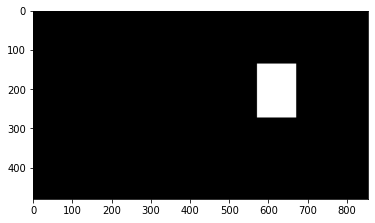

bike-packing


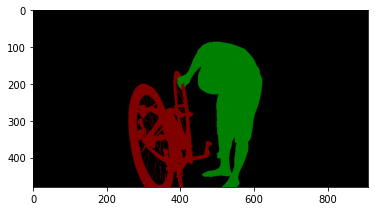

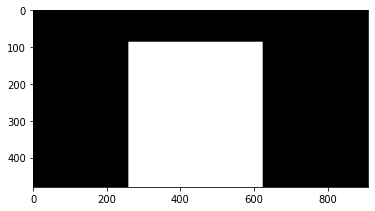

camel


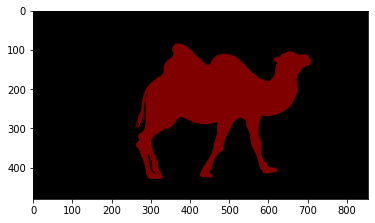

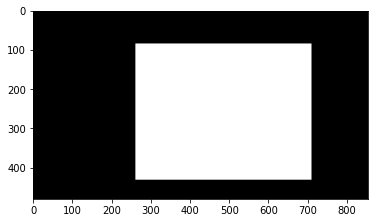

color-run


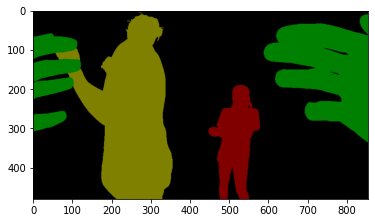

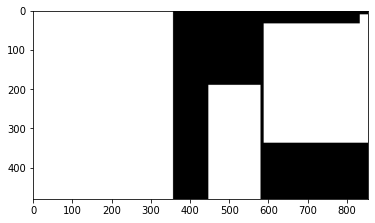

loading


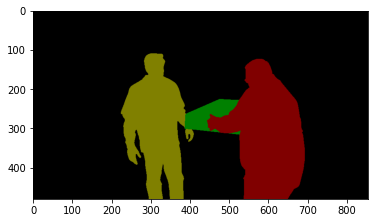

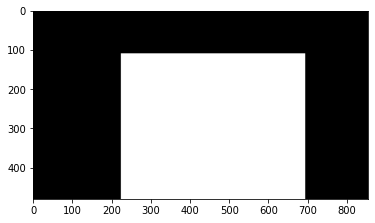

lady-running


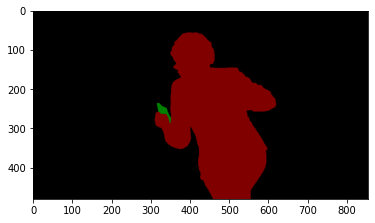

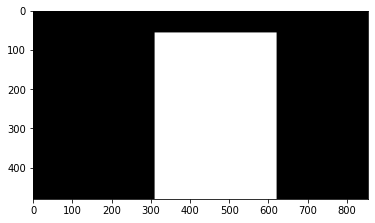

longboard


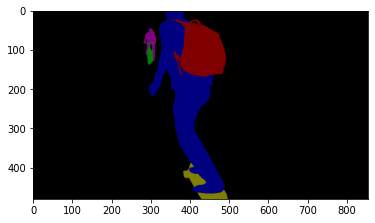

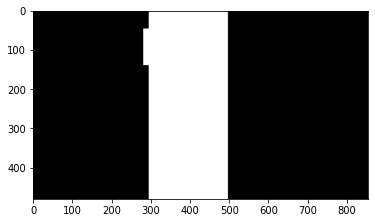

scooter-gray


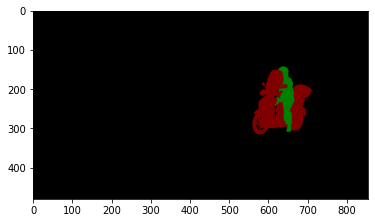

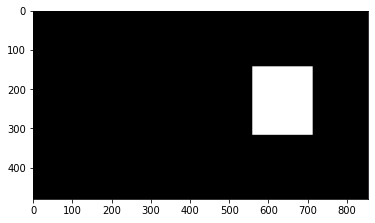

scooter-board


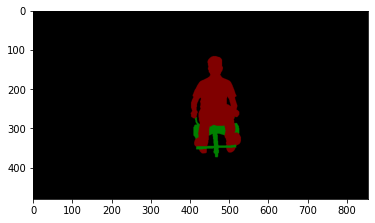

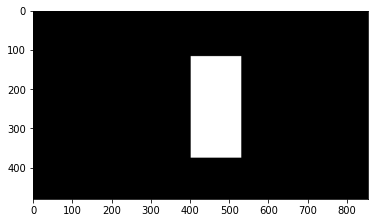

car-shadow


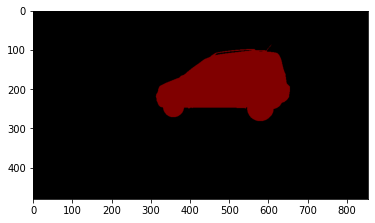

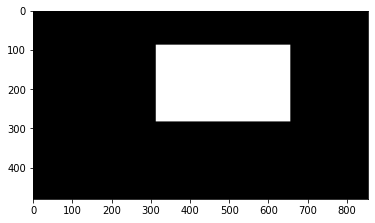

hockey


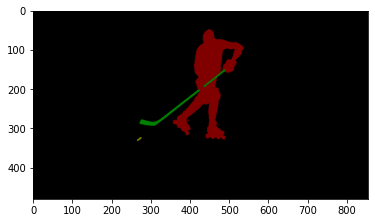

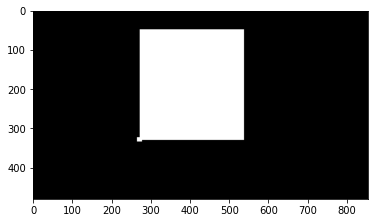

train


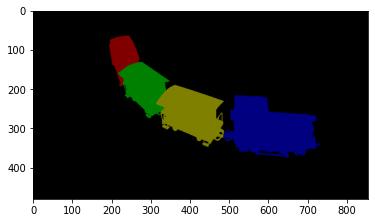

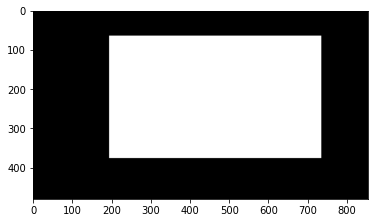

skate-park


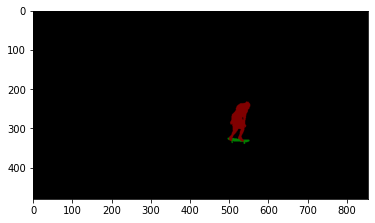

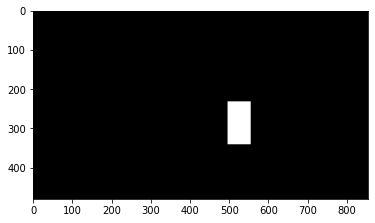

drift-straight


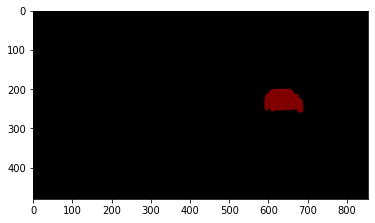

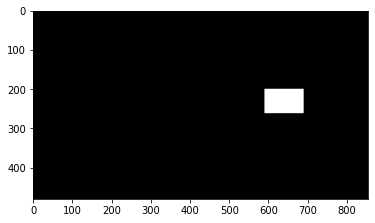

dance-jump


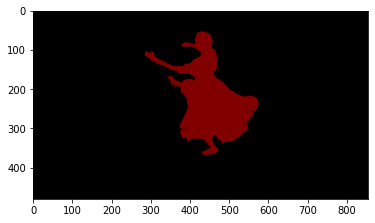

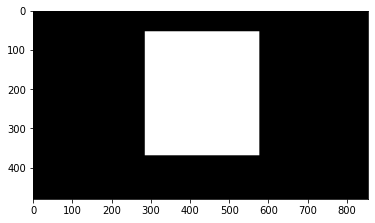

In [34]:
def create_bbox(mask, path_to_save):   
    video = mask.split('/')[-2]
    print(video)
    mask = Image.open(mask)
    plt.imshow(mask,cmap='gray')
    plt.show()
    mask = np.array(mask)
    mask_bin = np.zeros((mask.shape[0], mask.shape[1]))
    mask_bin = mask_bin.astype(np.bool)
    
    contours, hierarchy  = cv2.findContours(mask.copy(), 1, 1) # not copying here will throw an error
    try: hierarchy = hierarchy[0]
    except: hierarchy = []
        
    for contour, hier in zip(contours, hierarchy):
        (x,y,w,h) = cv2.boundingRect(contour)
        mask_i = cv2.rectangle(mask.copy(), (x,y), (x+w,y+h), (255, 0, 0), -1)
        mask_bin = (mask_i|mask_bin)
    
    plt.imshow(mask_bin,cmap='gray')
    plt.show()
    mask_bin = Image.fromarray(mask_bin) 

    #Saving
    os.makedirs(os.path.join(path_to_save,video),exist_ok=True)   
    mask_bin.save(os.path.join(path_to_save,video,'00000.png'))

    
path_to_save = '../bbox_gt'
os.makedirs(path_to_save,exist_ok=True)
for dir in os.listdir('../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p'):
    mask = os.path.join('../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p',dir,'00000.png')
    create_bbox(mask, path_to_save)


We need to slightly adapt the segment_first_frame function to take into account the ground-truth bounding boxes 

In [35]:
def segment_first_frame(jpg_first_frame_path, output_path, bbox_path, method='mask-RCNN'):
    try :
        cfg = get_cfg()
        if method=='mask-RCNN':
            cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
            cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
            cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
            predictor = DefaultPredictor(cfg)

        elif method=='PointRend':            

            point_rend.add_pointrend_config(cfg)
            cfg.merge_from_file("projects/PointRend/configs/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco.yaml")
            cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
            # Use a model from PointRend model zoo: https://github.com/facebookresearch/detectron2/tree/master/projects/PointRend#pretrained-models
            cfg.MODEL.WEIGHTS = "detectron2://PointRend/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco/164955410/model_final_edd263.pkl"
            predictor = DefaultPredictor(cfg)

        for video in sorted(os.listdir(jpg_first_frame_path)):
            print(video)
            first_frame = os.path.join(jpg_first_frame_path, video,'00000.jpg')
            bbox_gt = cv2.imread(os.path.join(bbox_path, video,'00000.png'))[:, :, 0]
            bbox_gt = bbox_gt.astype(np.bool)
            
            im = cv2.imread(first_frame)  
            pred_segmentation = predictor(im)
            if len(pred_segmentation['instances'].pred_masks.cpu().numpy())>0 :                                        
                mask_bin = np.zeros((im.shape[0], im.shape[1]))
                mask_bin = mask_bin.astype(np.bool)
                max_surface = 0            
                for i in range(len(pred_segmentation['instances'])):
                    surface_mask = get_surface_object(pred_segmentation['instances'].pred_masks.cpu().numpy()[i])
                    if surface_mask>max_surface:
                        max_surface = surface_mask
                        idx_max_surface = i
                    if np.sum((pred_segmentation['instances'].pred_masks.cpu().numpy()[i] & bbox_gt))> 0.1*np.sum(bbox_gt):
                        mask_bin_i = pred_segmentation['instances'].pred_masks.cpu().numpy()[i]
                        mask_bin = (mask_bin_i | mask_bin)               
                if np.sum(mask_bin)==0:
                    mask_bin = pred_segmentation['instances'].pred_masks.cpu().numpy()[idx_max_surface]
            
            plt.imshow(im,cmap='gray')
            plt.show()
            plt.imshow(mask_bin,cmap='gray')
            plt.show()
            
            #Saving
            os.makedirs(os.path.join(output_path,video),exist_ok=True)            
            mask_bin = Image.fromarray(mask_bin) 
            mask_bin.save(os.path.join(output_path,video,'00000.png'))

                
    except :
        print('Error : Choose a method between mask-RCNN or PointRend')

bear


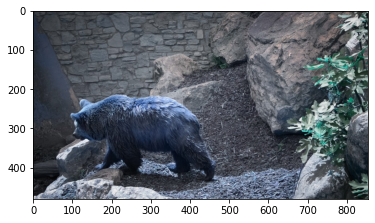

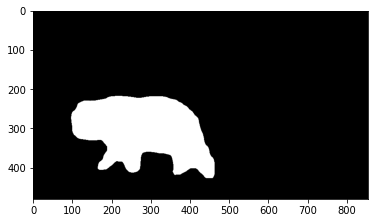

bike-packing


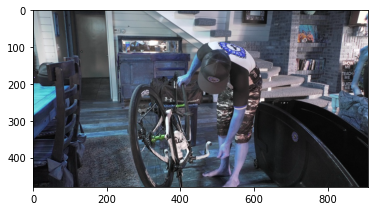

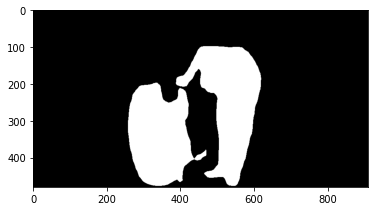

blackswan


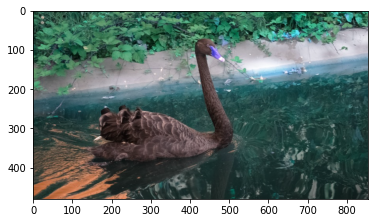

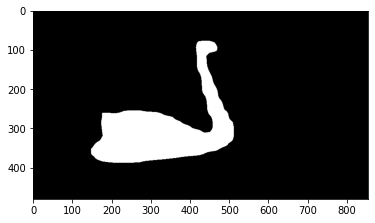

bmx-bumps


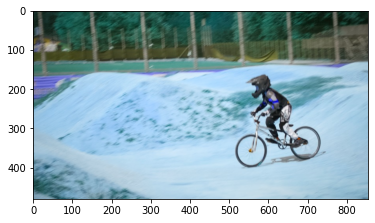

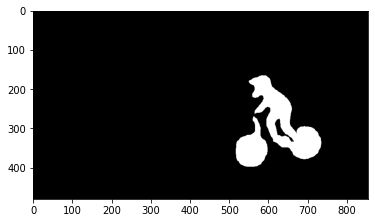

bmx-trees


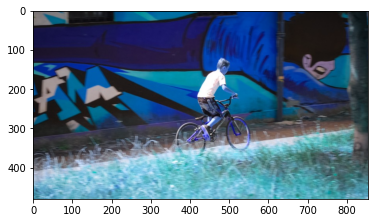

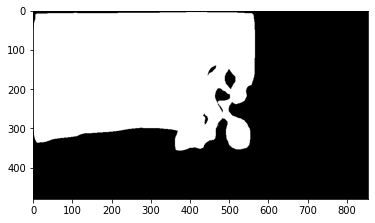

boat


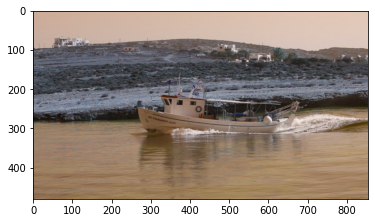

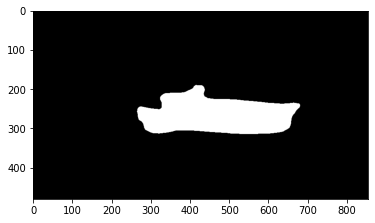

boxing-fisheye


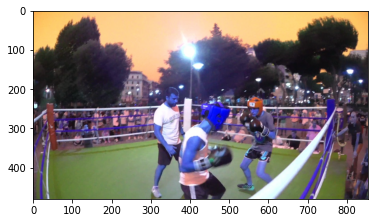

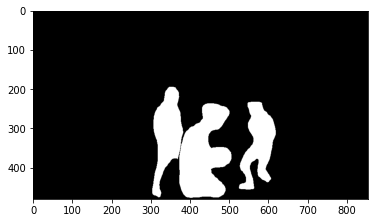

breakdance


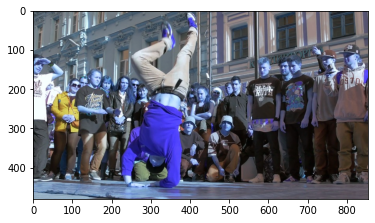

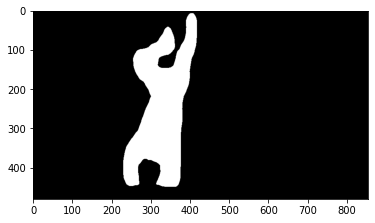

breakdance-flare


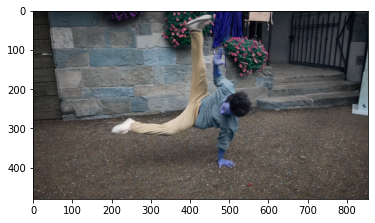

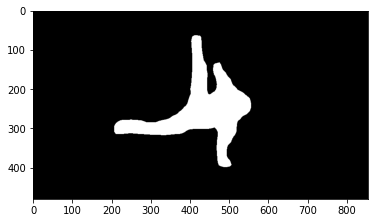

bus


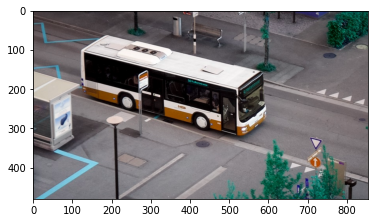

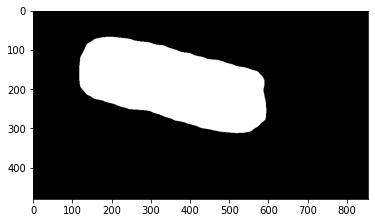

camel


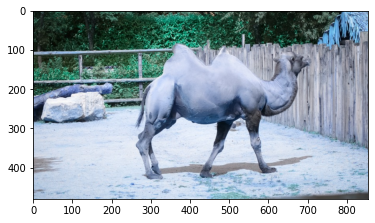

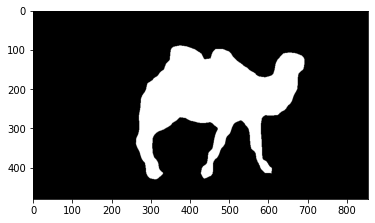

car-roundabout


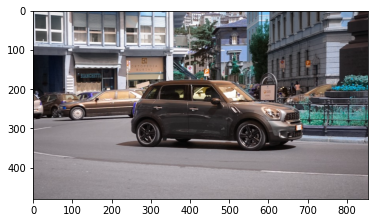

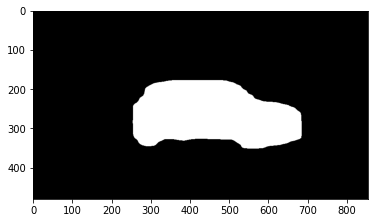

car-shadow


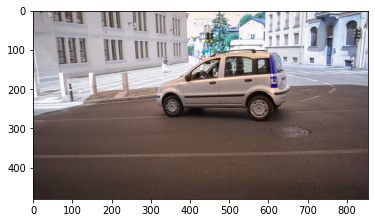

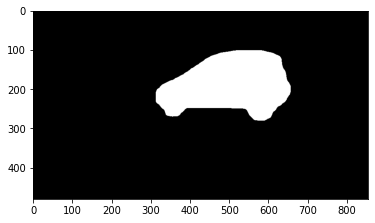

car-turn


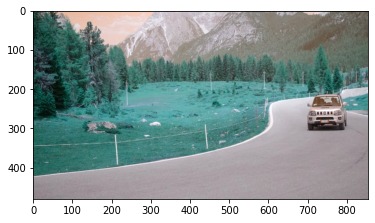

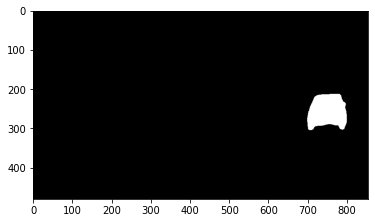

cat-girl


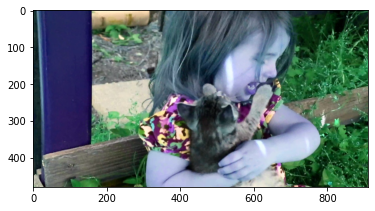

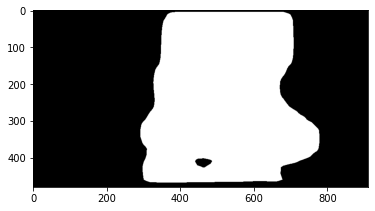

classic-car


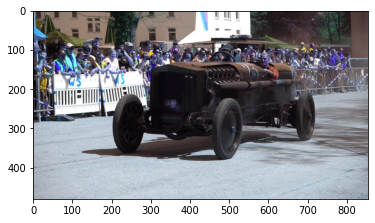

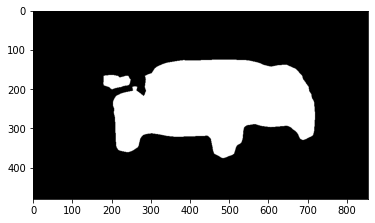

color-run


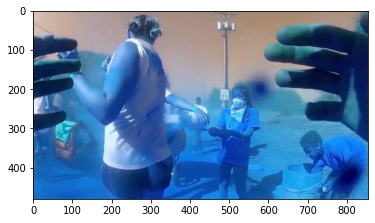

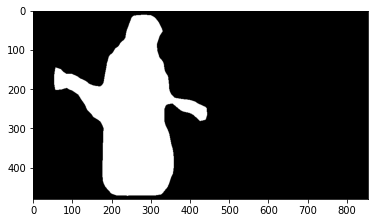

cows


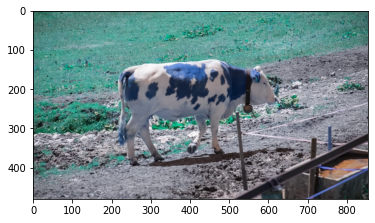

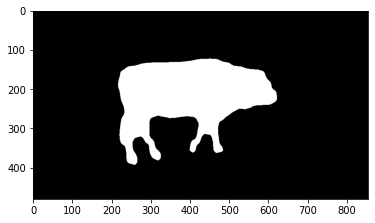

crossing


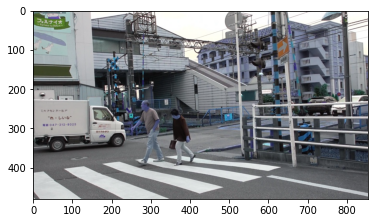

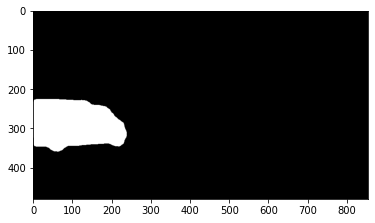

dance-jump


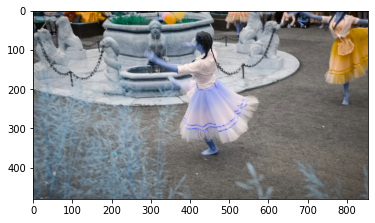

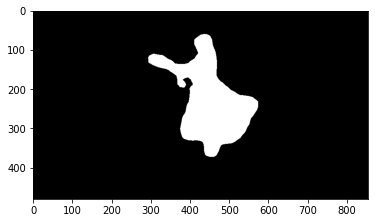

dance-twirl


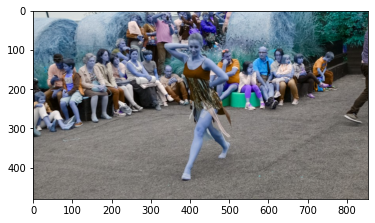

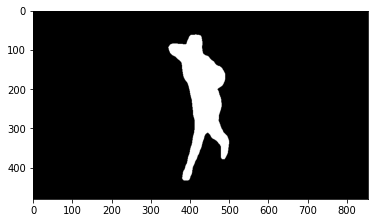

dancing


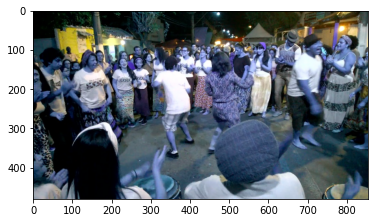

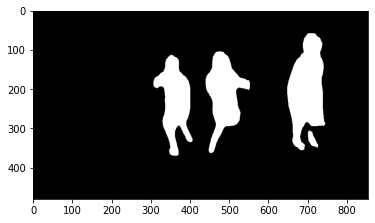

disc-jockey


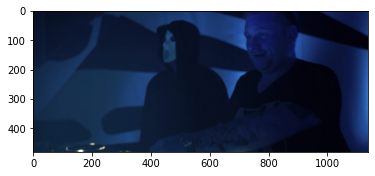

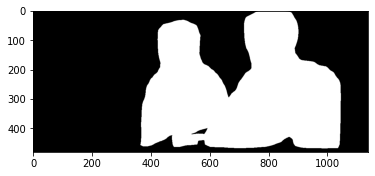

dog


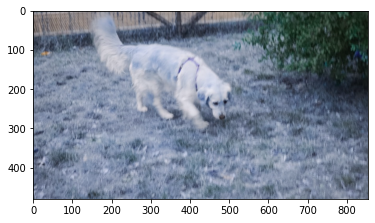

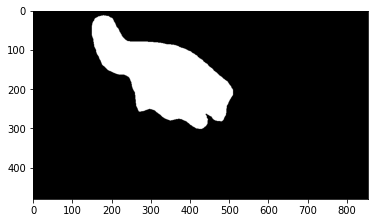

dog-agility


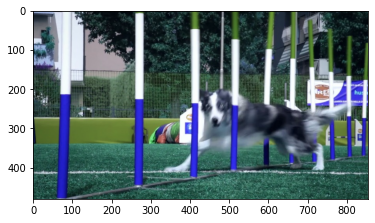

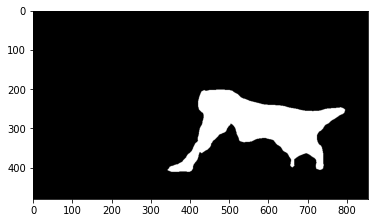

dog-gooses


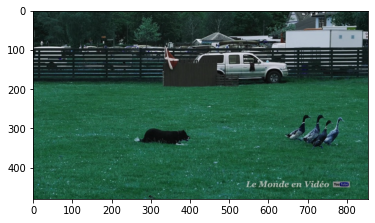

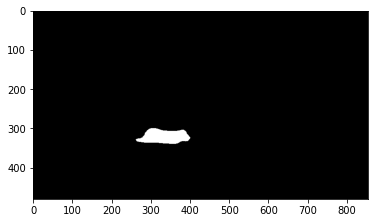

dogs-jump


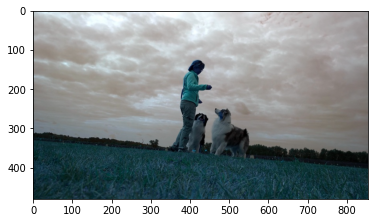

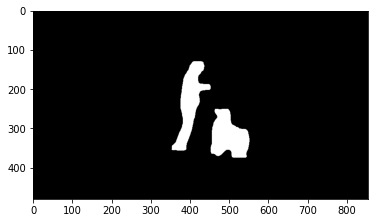

dogs-scale


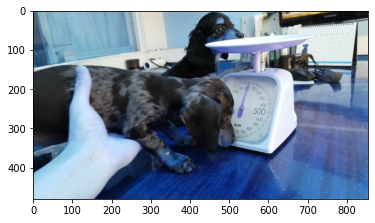

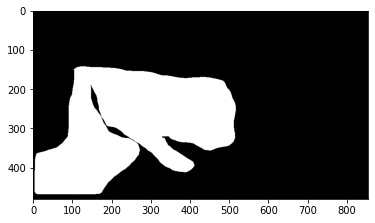

drift-chicane


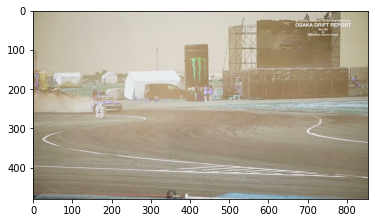

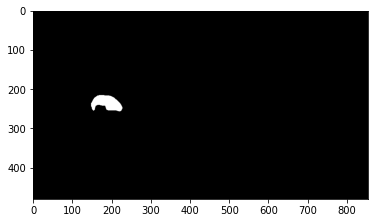

drift-straight


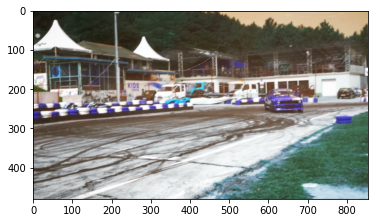

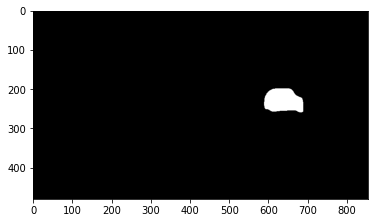

drift-turn


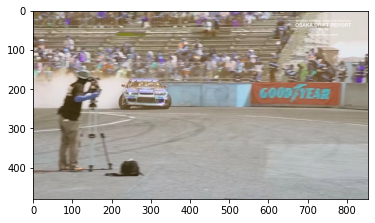

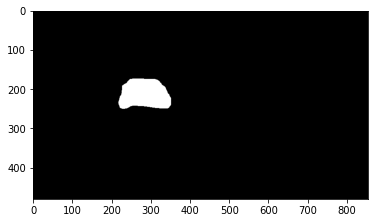

drone


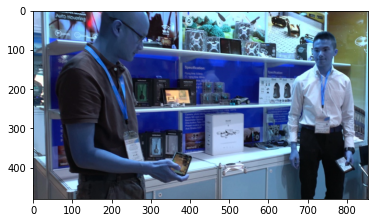

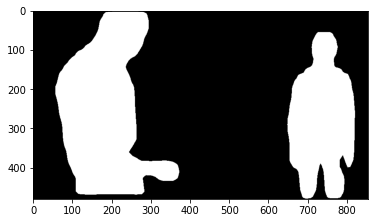

elephant


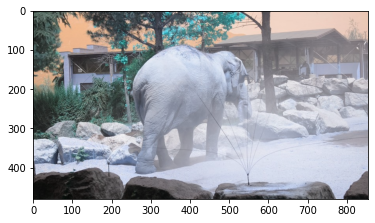

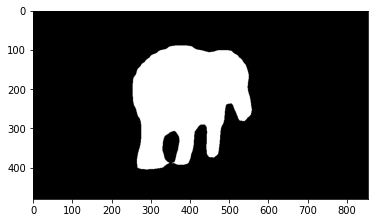

flamingo


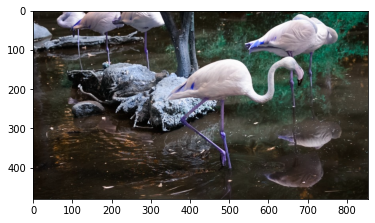

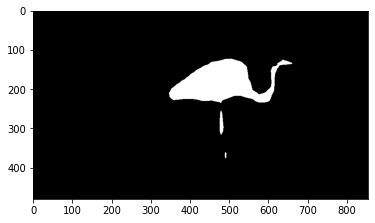

goat


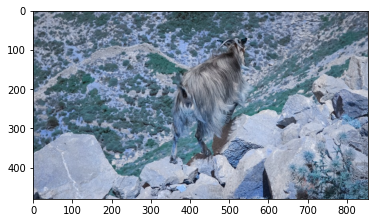

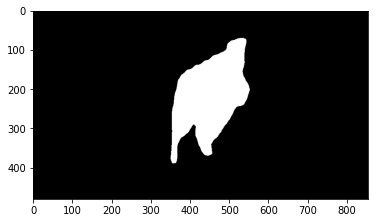

gold-fish


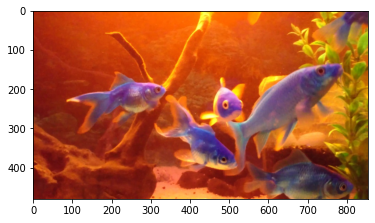

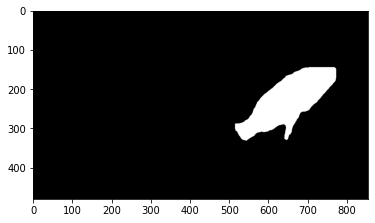

hike


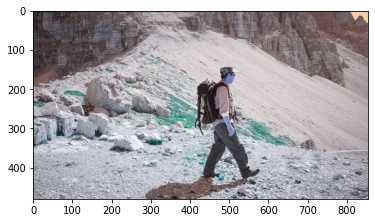

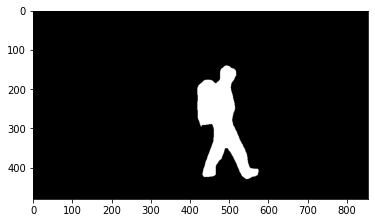

hockey


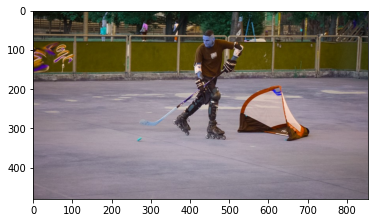

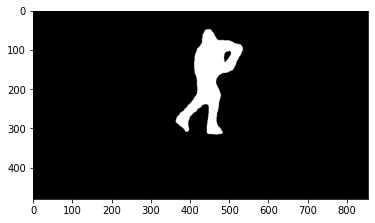

horsejump-high


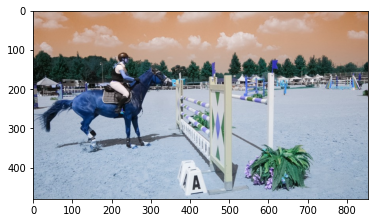

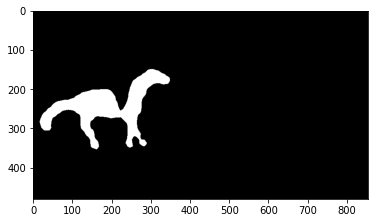

horsejump-low


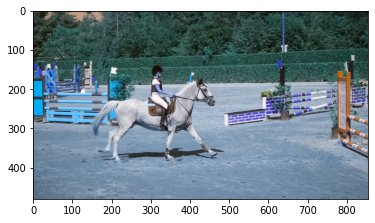

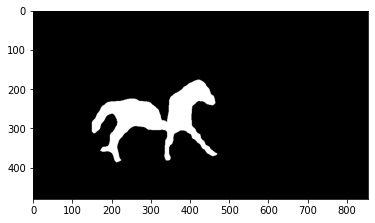

india


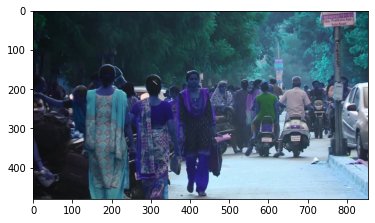

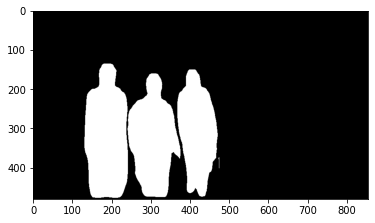

judo


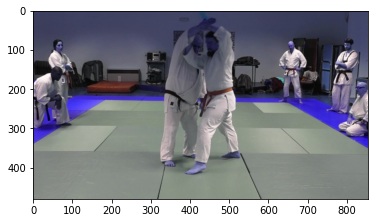

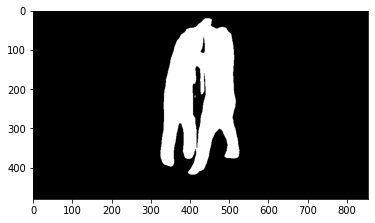

kid-football


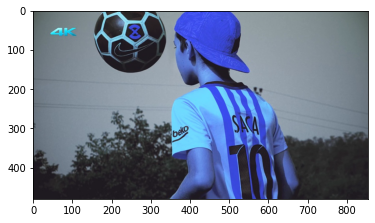

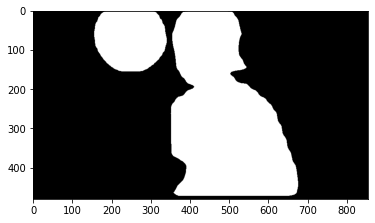

kite-surf


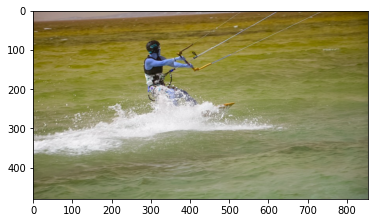

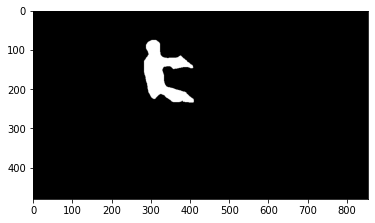

kite-walk


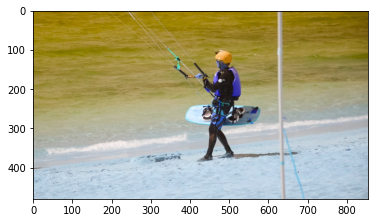

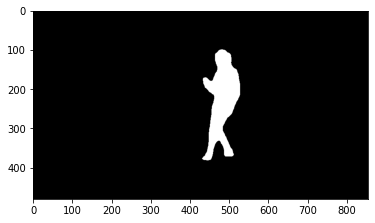

koala


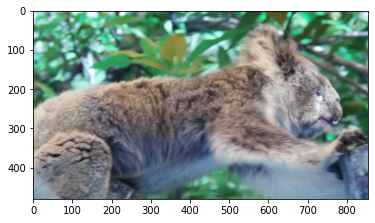

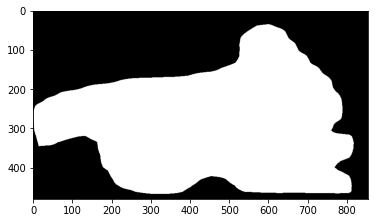

lab-coat


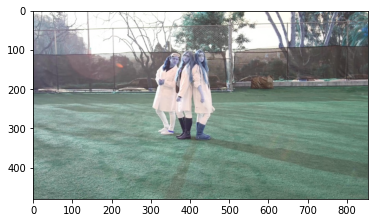

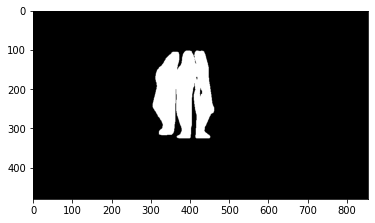

lady-running


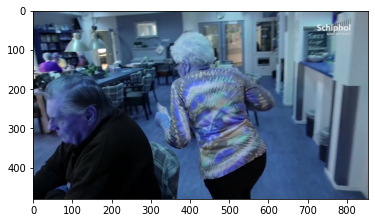

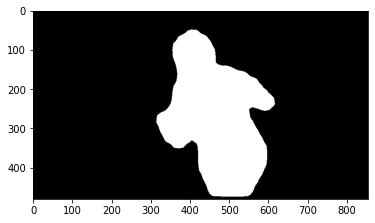

libby


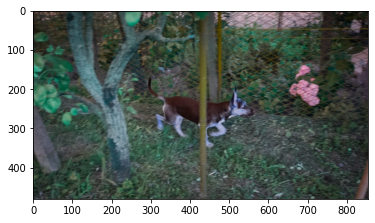

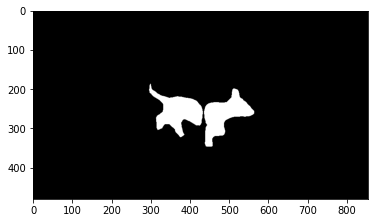

lindy-hop


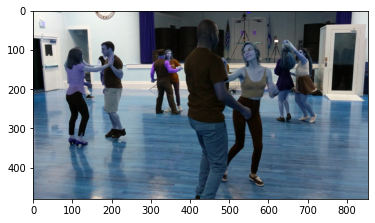

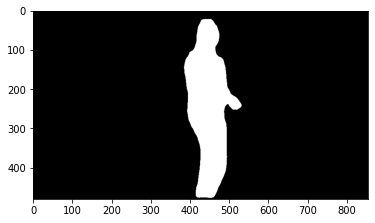

loading


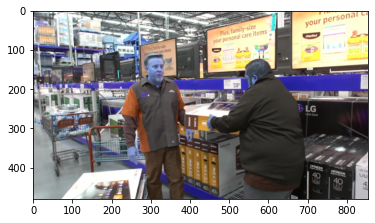

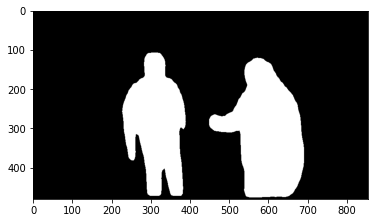

longboard


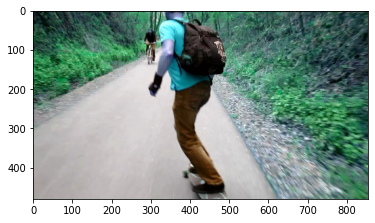

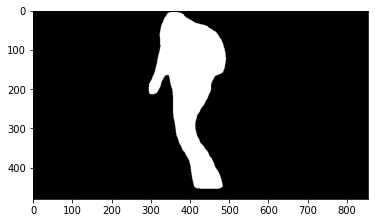

lucia


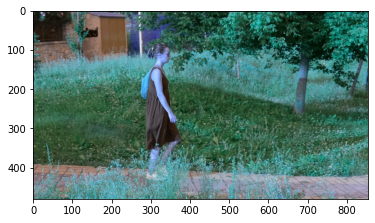

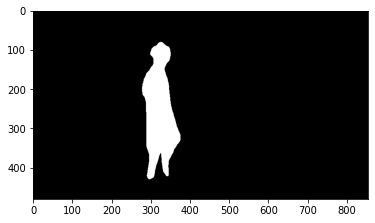

mallard-fly


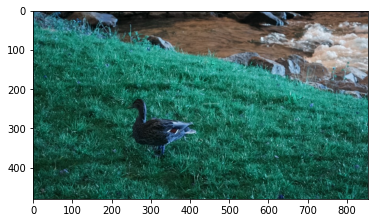

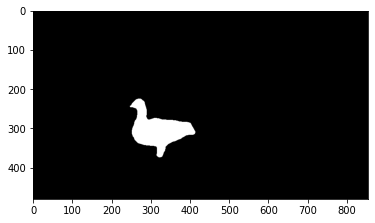

mallard-water


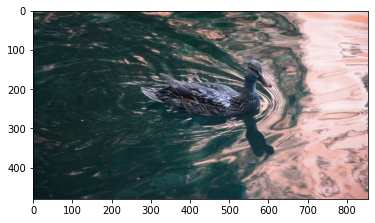

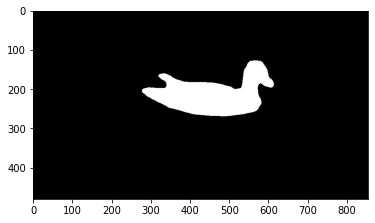

mbike-trick


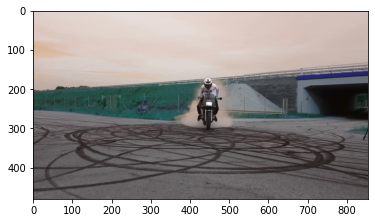

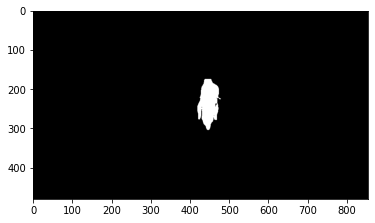

miami-surf


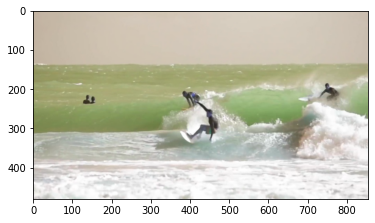

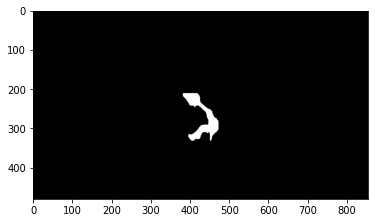

motocross-bumps


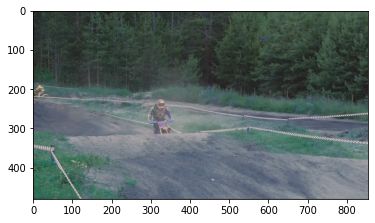

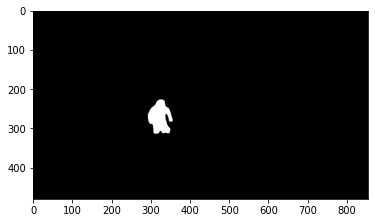

motocross-jump


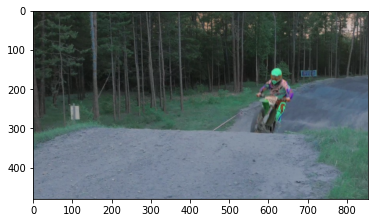

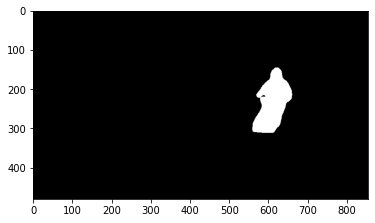

motorbike


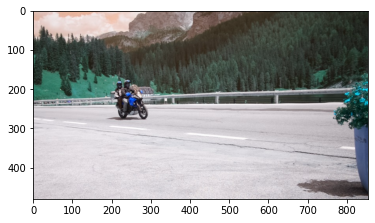

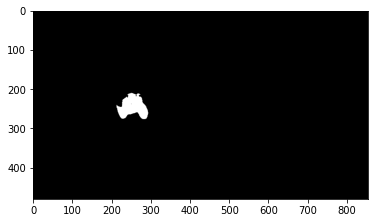

night-race


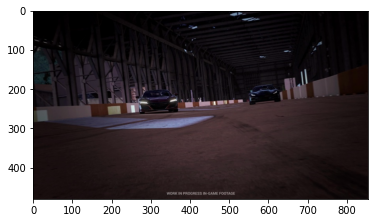

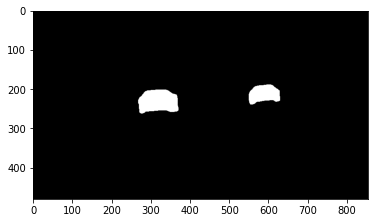

paragliding


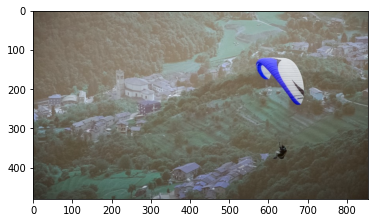

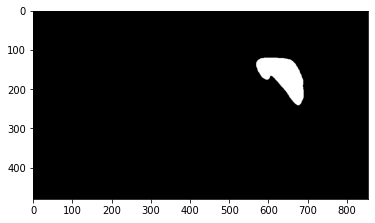

paragliding-launch


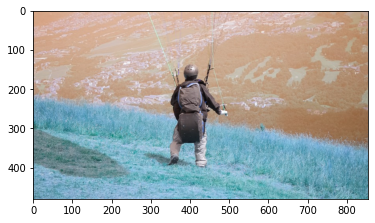

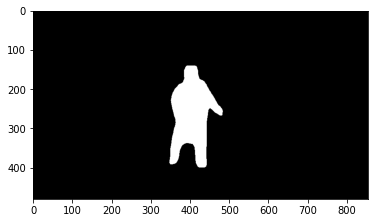

parkour


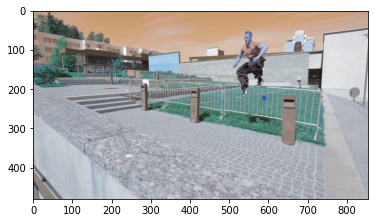

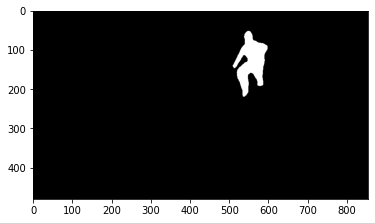

pigs


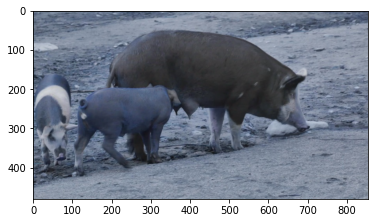

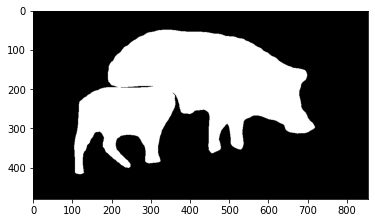

planes-water


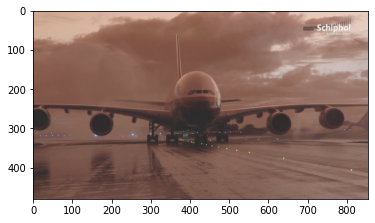

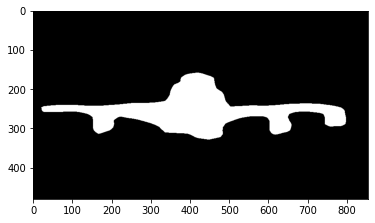

rallye


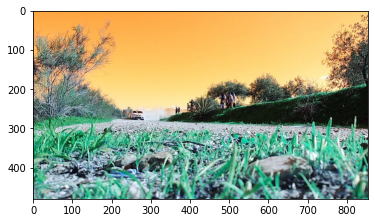

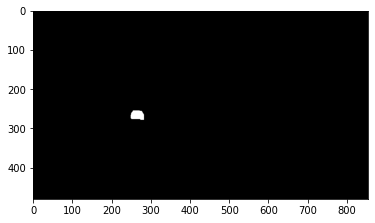

rhino


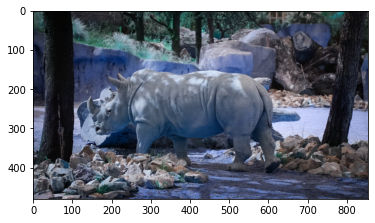

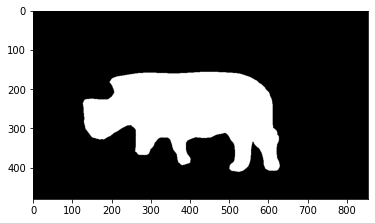

rollerblade


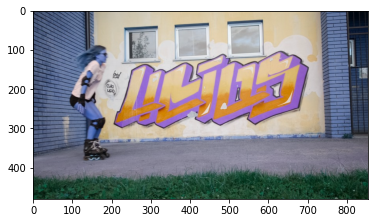

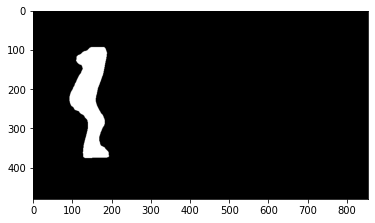

schoolgirls


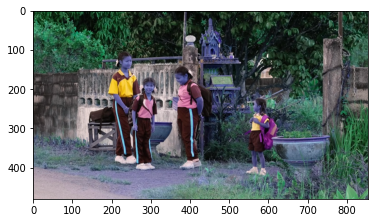

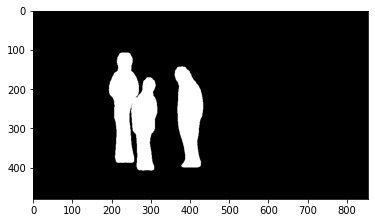

scooter-black


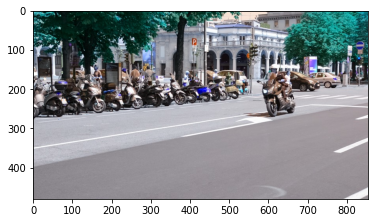

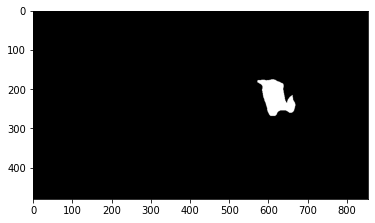

scooter-board


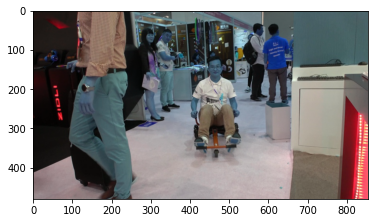

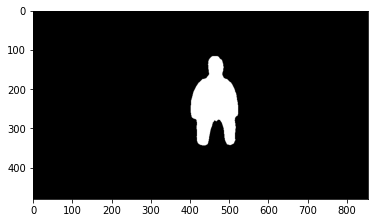

scooter-gray


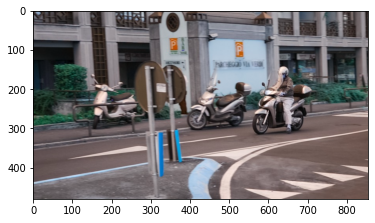

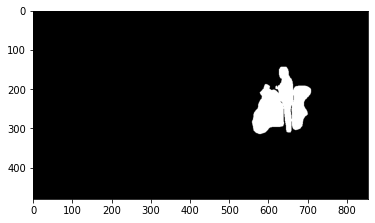

sheep


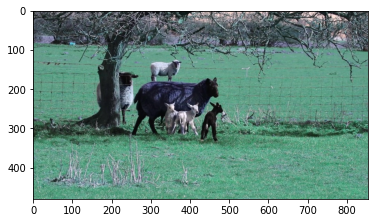

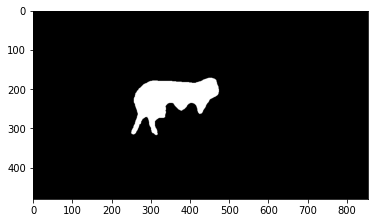

shooting


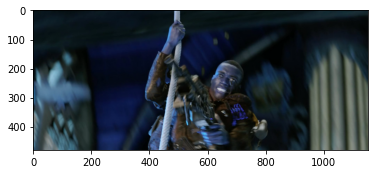

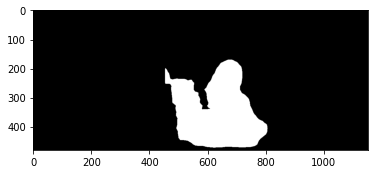

skate-park


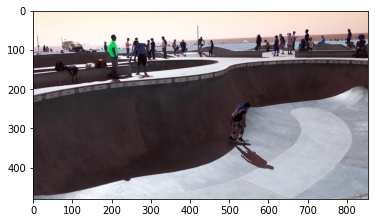

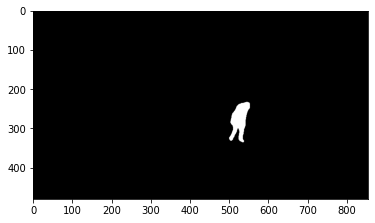

snowboard


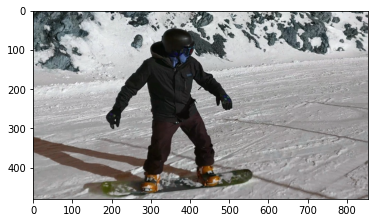

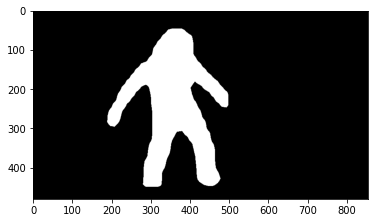

soapbox


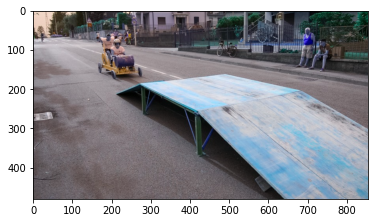

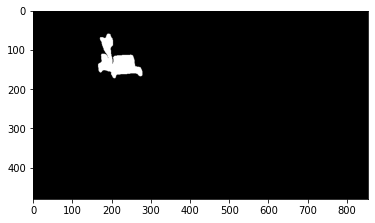

soccerball


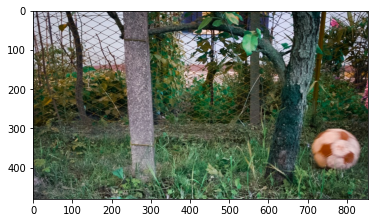

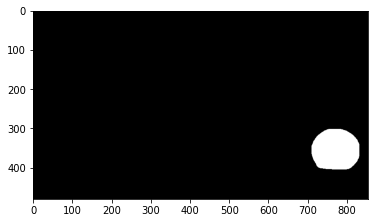

stroller


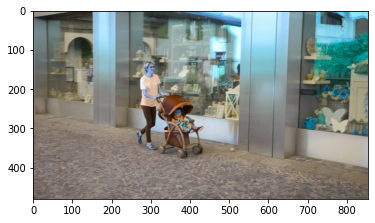

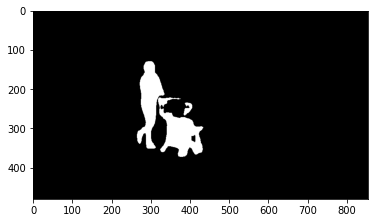

stunt


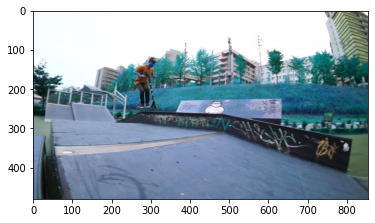

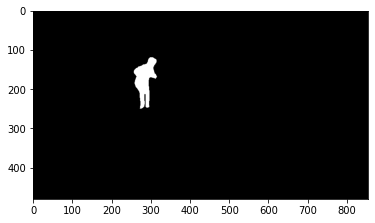

surf


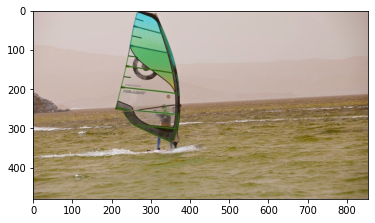

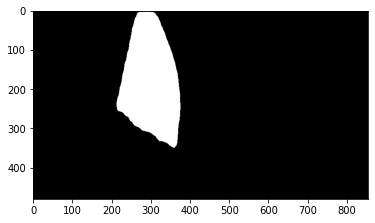

swing


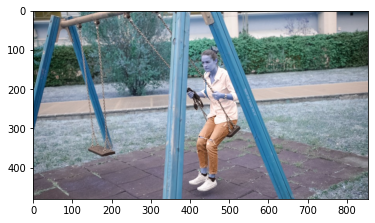

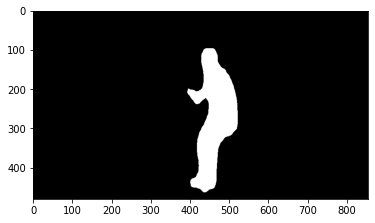

tennis


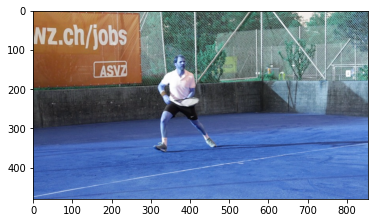

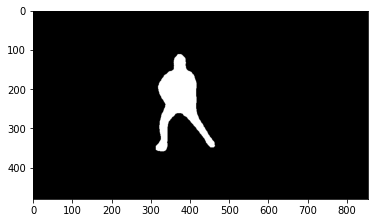

tractor-sand


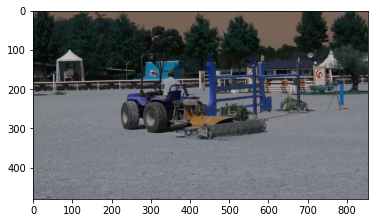

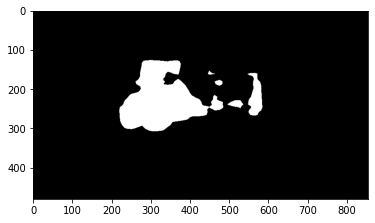

train


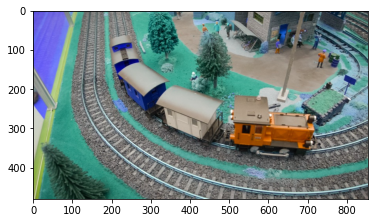

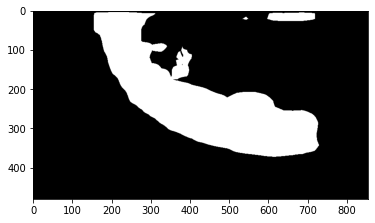

tuk-tuk


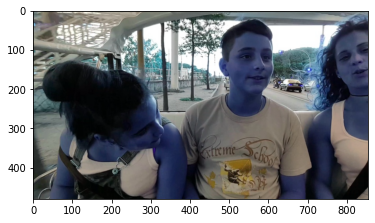

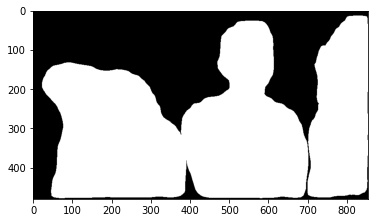

upside-down


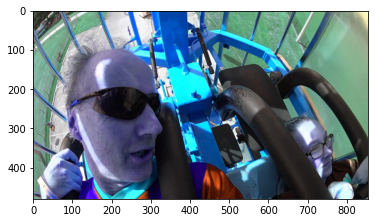

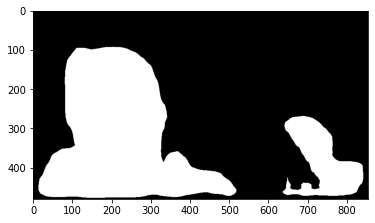

varanus-cage


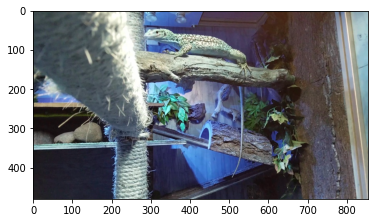

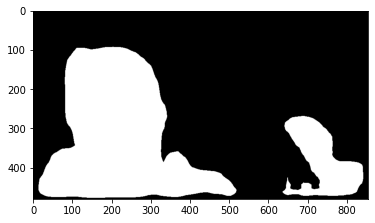

Error : Choose a method between mask-RCNN or PointRend


In [36]:
jpg_first_frame_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p'
output_path = '../segmentation_1st_frame_Mask_RCNN_corrected'

segment_first_frame(jpg_first_frame_path, output_path, bbox_path ='../bbox_gt')

In [37]:
os.chdir('../detectron2_repo')

In [38]:
import shutil 

if os.path.isdir('../copydavis_maskrccn'):
    shutil.rmtree('../copydavis_maskrccn')

#Copy Davis directories
shutil.copytree('../../input/davis480dataset','../copydavis_maskrccn')

#Remove the ground-truth annotations from copydavis
list_dir = os.listdir('../copydavis_maskrccn/DAVIS_TRAIN/DAVIS/Annotations/480p')
for video in list_dir:
    shutil.rmtree(os.path.join('../copydavis_maskrccn/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
    

 
#Convert from 1 channel to 3 channels the segmentation produced by Mask-RCNN and save in tmp directory
for video in os.listdir('../segmentation_1st_frame_Mask_RCNN_corrected'):
    os.makedirs(os.path.join('temp',video))
    for frame in os.listdir(os.path.join('../segmentation_1st_frame_Mask_RCNN_corrected',video)):
        img = Image.open(os.path.join('../segmentation_1st_frame_Mask_RCNN_corrected',video,frame)).convert('P')
        img.save(os.path.join('temp',video,frame))
        
#Copy from tmp to copydavis
for video in os.listdir('temp'):
    shutil.copytree(os.path.join('temp', video), os.path.join('../copydavis_maskrccn/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
        
#Delete tmp directory    
shutil.rmtree('temp')

#Clone STCN and infer the segmentation for the Davis dataset based on PointRend's first frame segmentation
os.chdir('../STCN')
!python eval_davis.py --output 'out_validation_2017_MaskRCNN_corrected' --davis_path ../copydavis_maskrccn/DAVIS_TRAIN/DAVIS/ --model '../../input/loadingsstcn/stcn.pth'                     

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
100% (30 of 30) |########################| Elapsed Time: 0:02:44 Time:  0:02:44
Total pr

In [39]:
data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p'
data_dir_pred_segmentation = '../STCN/out_validation_2017_MaskRCNN_corrected'
list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes)
print(f'We obtain a J index of {np.mean(list_jaccard_davis) :.2f}, a F index of {np.mean(list_f_score_davis) :.2f} and a J&F index of {np.mean(list_j_and_f_davis) :.2f} on the training set')
      

Jaccard for category pigs : 0.69
F-score for category pigs : 0.81
J&F for category pigs : 0.75


Jaccard for category judo : 0.93
F-score for category judo : 0.96
J&F for category judo : 0.94


Jaccard for category motocross-jump : 0.90
F-score for category motocross-jump : 0.95
J&F for category motocross-jump : 0.93


Jaccard for category drift-chicane : 0.88
F-score for category drift-chicane : 0.93
J&F for category drift-chicane : 0.90


Jaccard for category dog : 0.90
F-score for category dog : 0.95
J&F for category dog : 0.93


Jaccard for category loading : 0.79
F-score for category loading : 0.88
J&F for category loading : 0.84


Jaccard for category india : 0.88
F-score for category india : 0.93
J&F for category india : 0.91


Jaccard for category dogs-jump : 0.66
F-score for category dogs-jump : 0.78
J&F for category dogs-jump : 0.72


Jaccard for category drift-straight : 0.94
F-score for category drift-straight : 0.97
J&F for category drift-straight : 0.95


Jaccard for cate

WARNING [01/25 19:41:36 d2.projects.point_rend.mask_head]: Weight format of PointRend models have changed! Applying automatic conversion now ...
bear


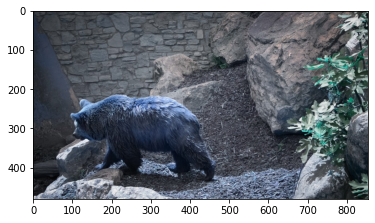

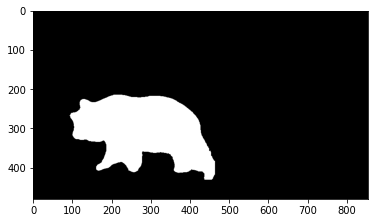

bike-packing


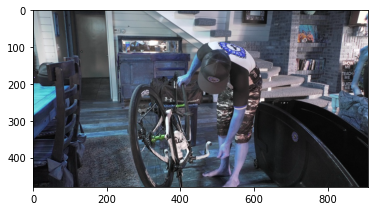

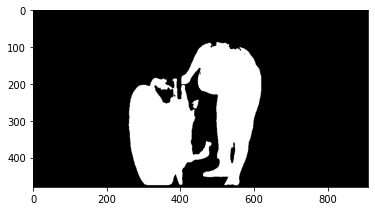

blackswan


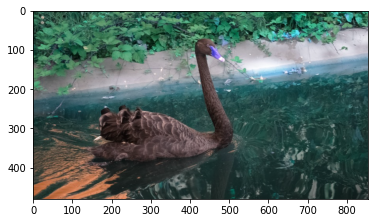

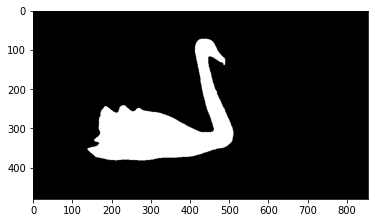

bmx-bumps


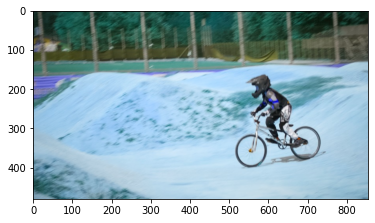

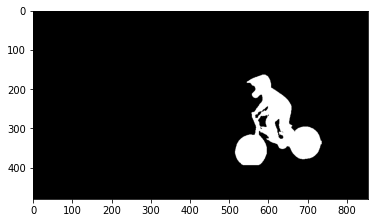

bmx-trees


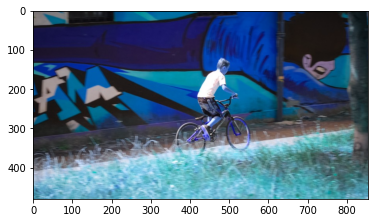

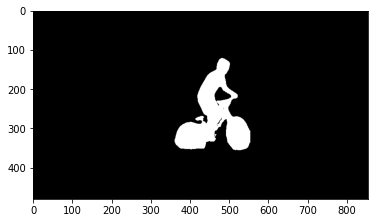

boat


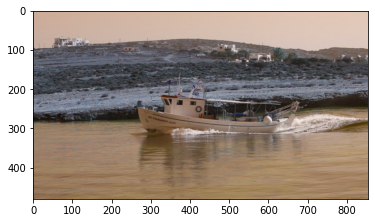

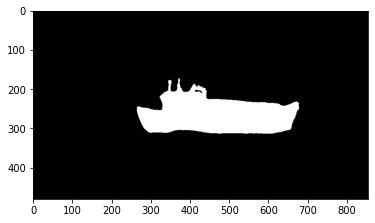

boxing-fisheye


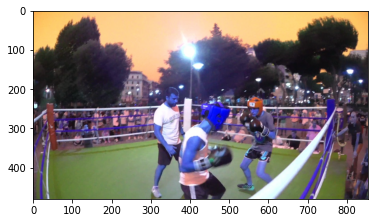

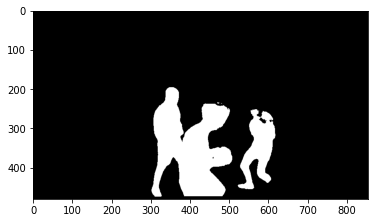

breakdance


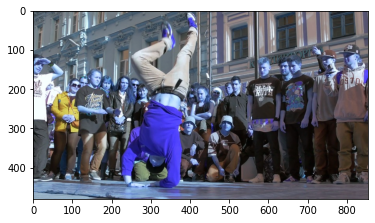

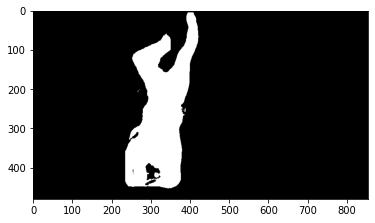

breakdance-flare


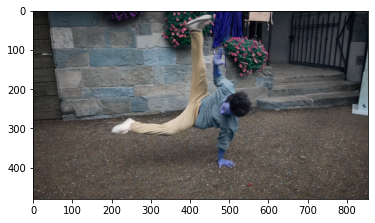

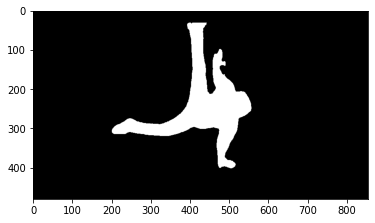

bus


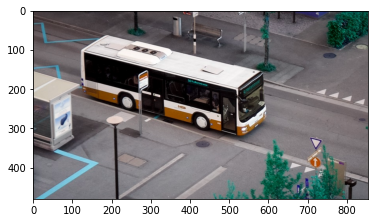

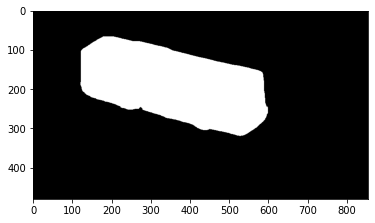

camel


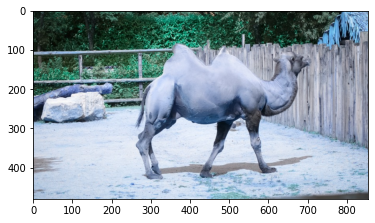

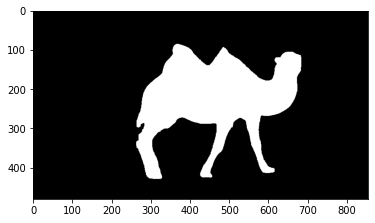

car-roundabout


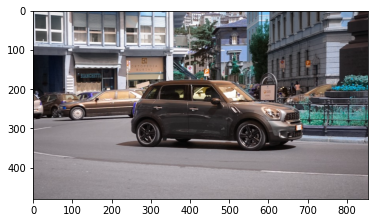

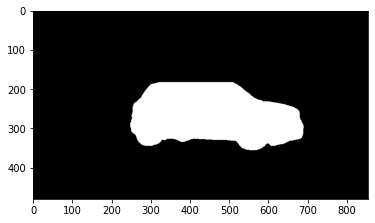

car-shadow


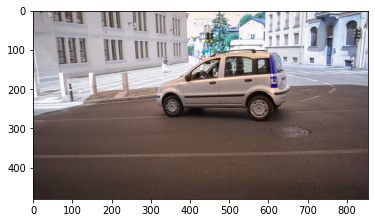

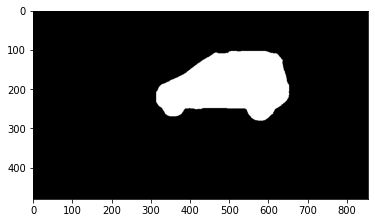

car-turn


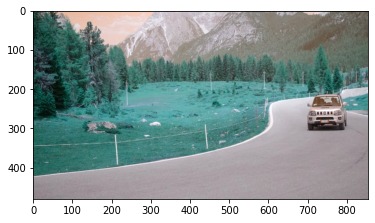

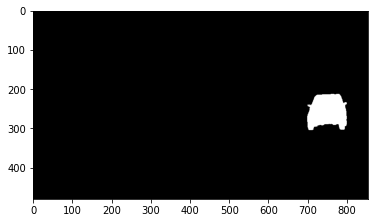

cat-girl


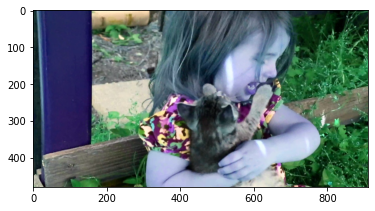

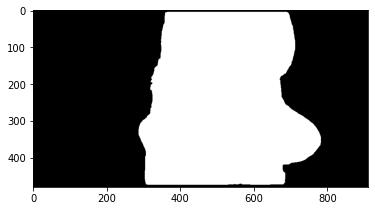

classic-car


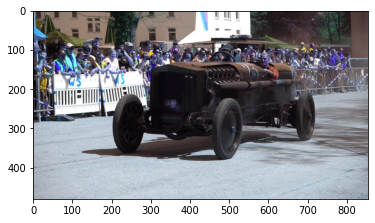

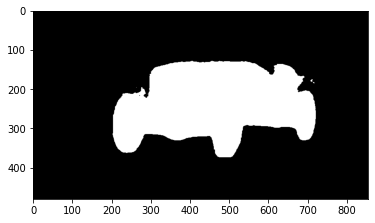

color-run


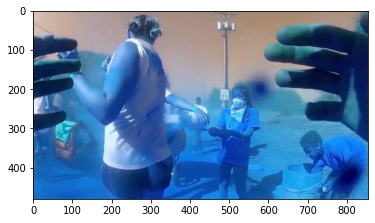

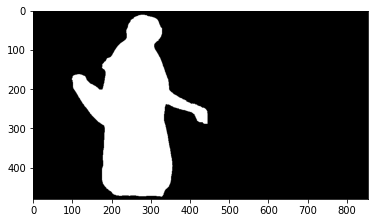

cows


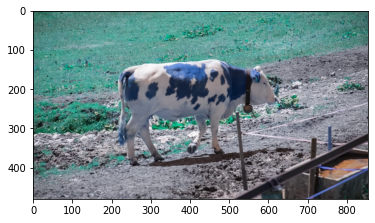

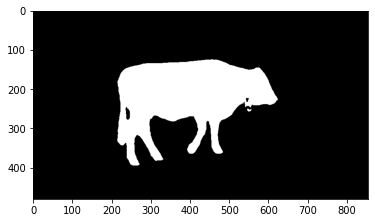

crossing


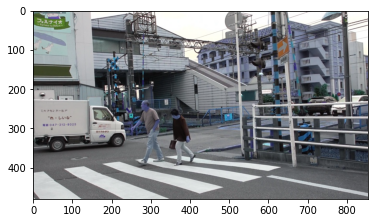

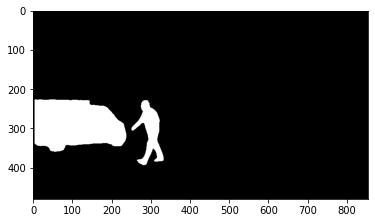

dance-jump


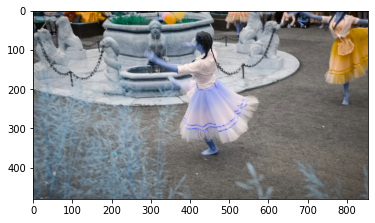

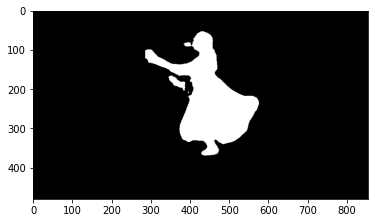

dance-twirl


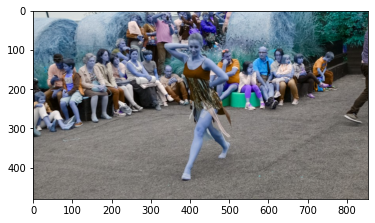

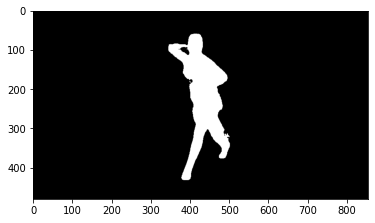

dancing


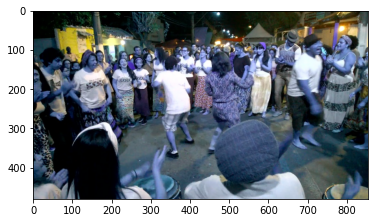

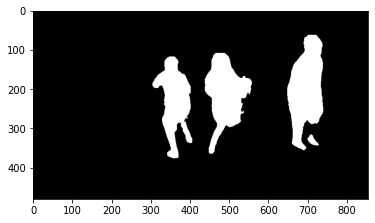

disc-jockey


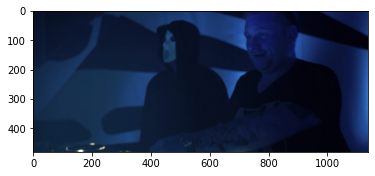

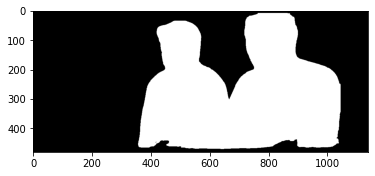

dog


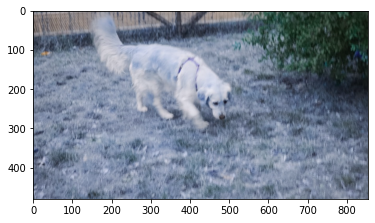

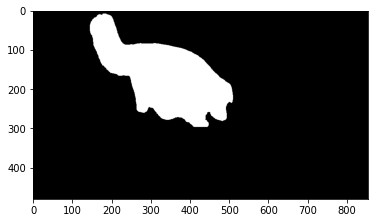

dog-agility


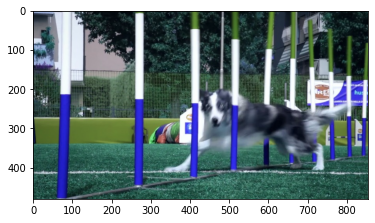

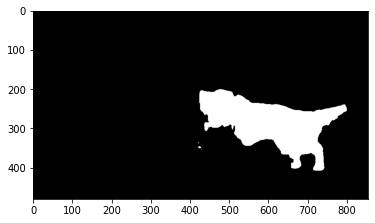

dog-gooses


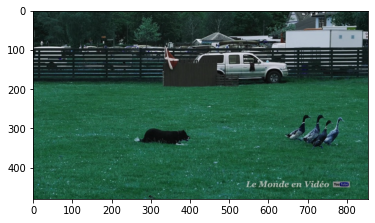

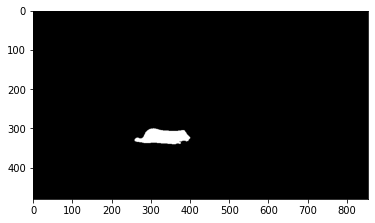

dogs-jump


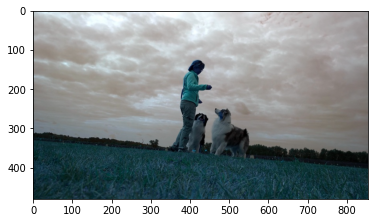

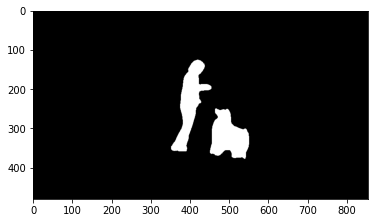

dogs-scale


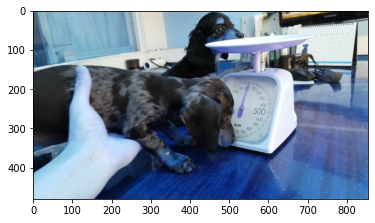

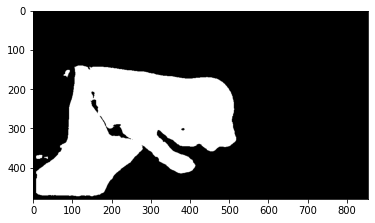

drift-chicane


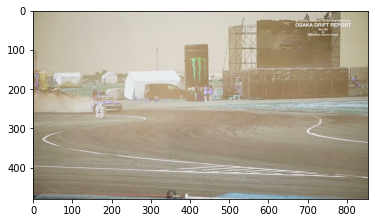

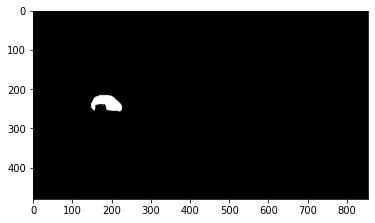

drift-straight


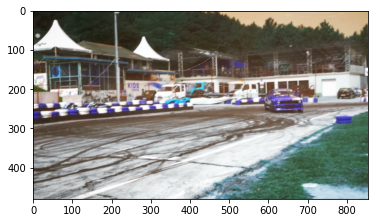

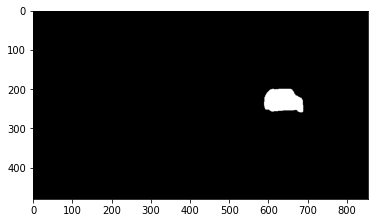

drift-turn


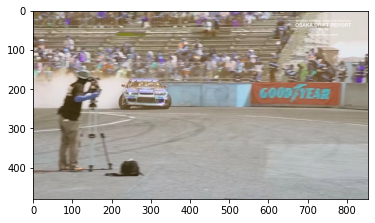

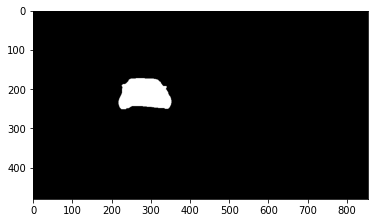

drone


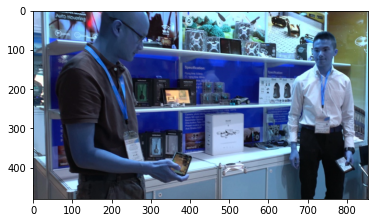

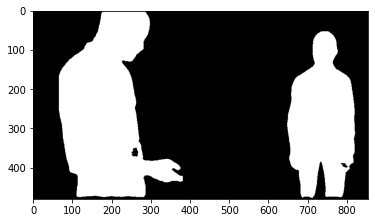

elephant


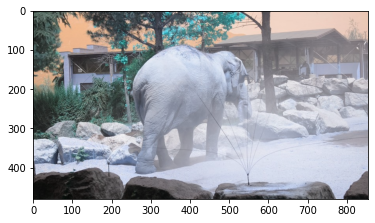

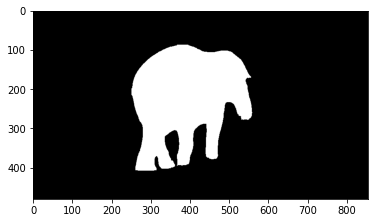

flamingo


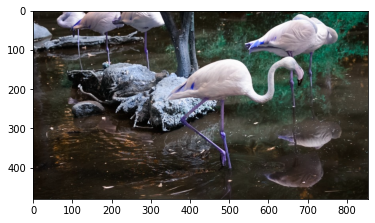

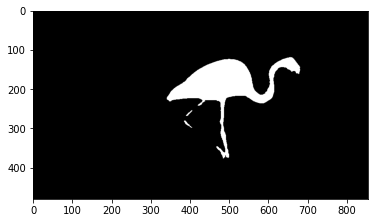

goat


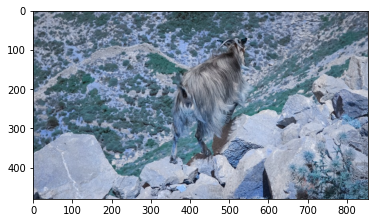

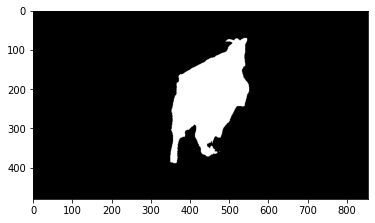

gold-fish


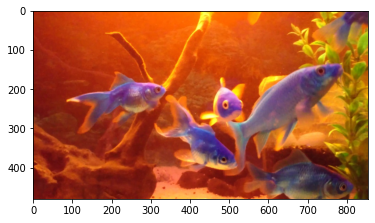

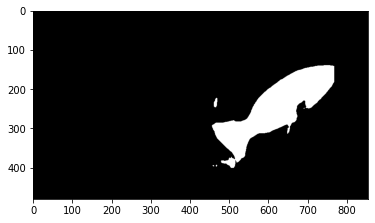

hike


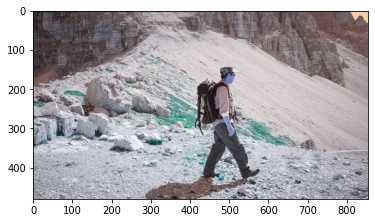

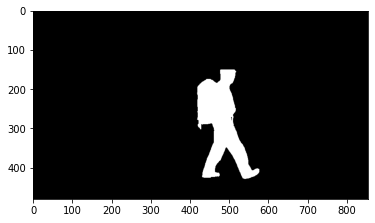

hockey


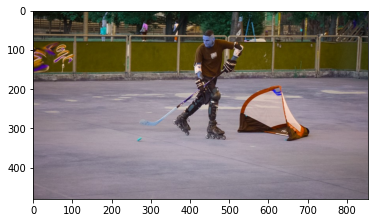

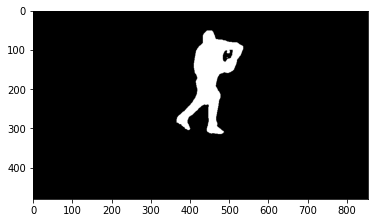

horsejump-high


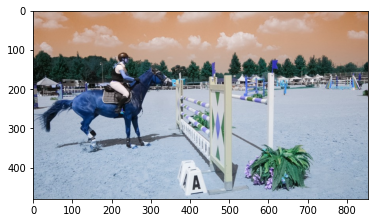

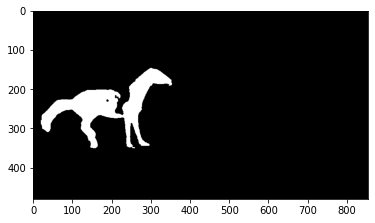

horsejump-low


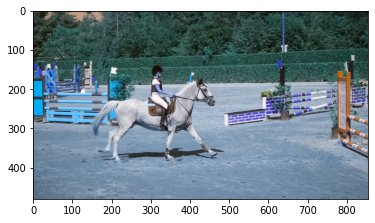

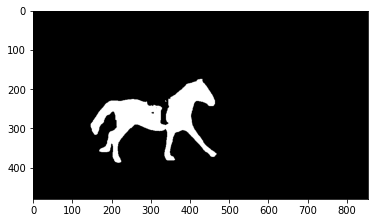

india


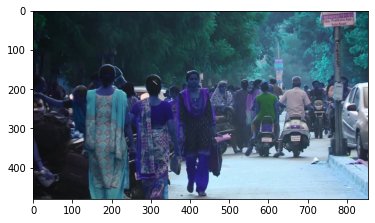

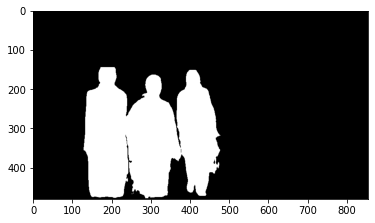

judo


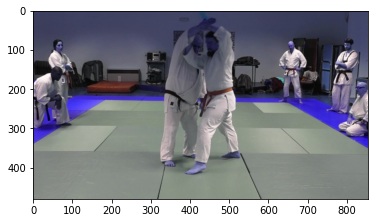

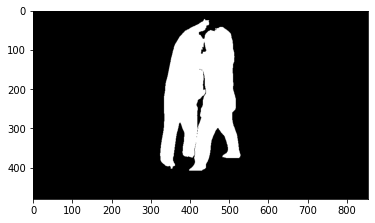

kid-football


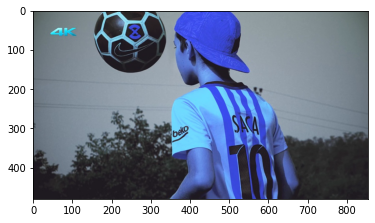

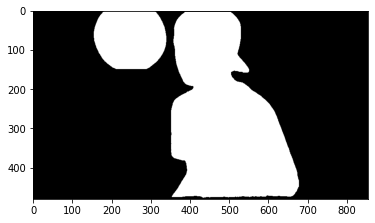

kite-surf


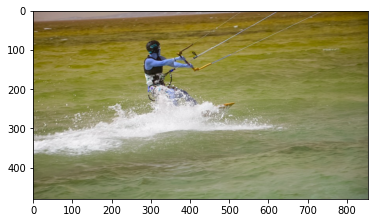

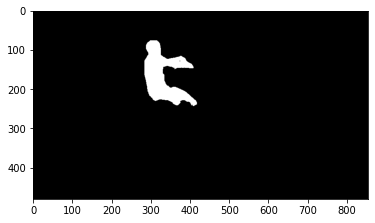

kite-walk


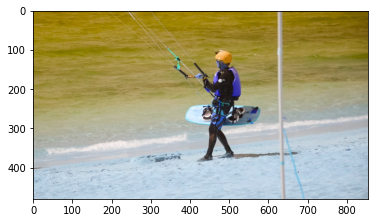

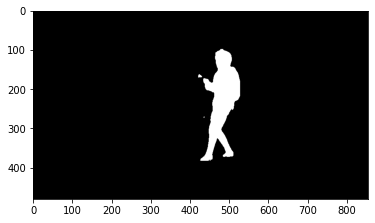

koala


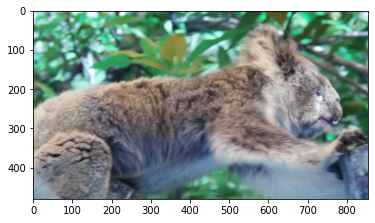

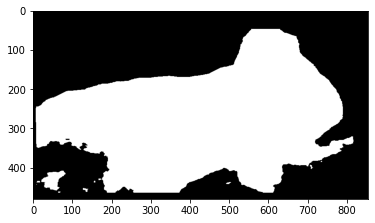

lab-coat


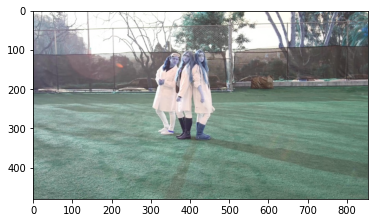

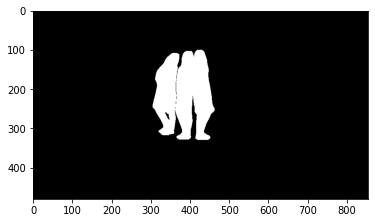

lady-running


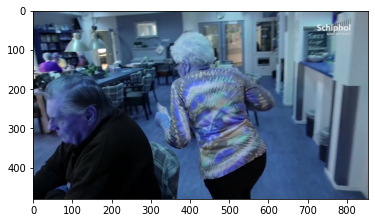

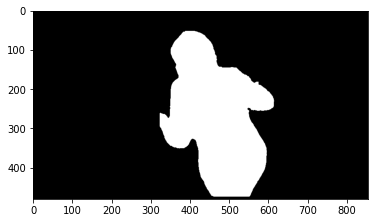

libby


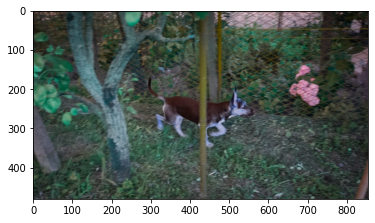

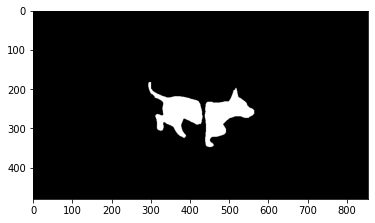

lindy-hop


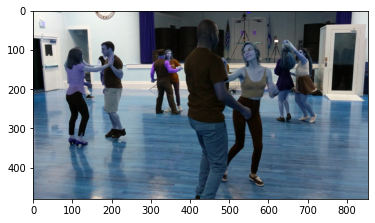

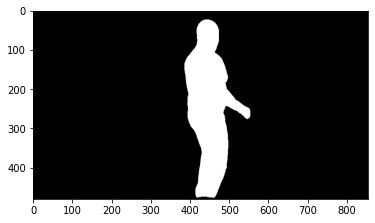

loading


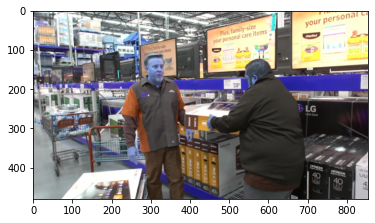

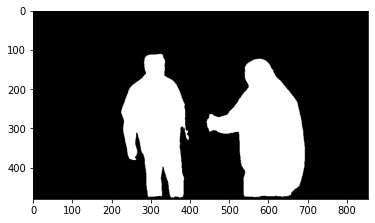

longboard


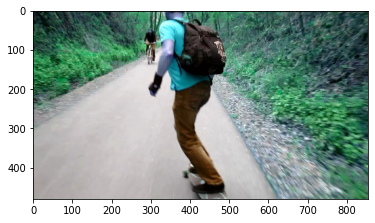

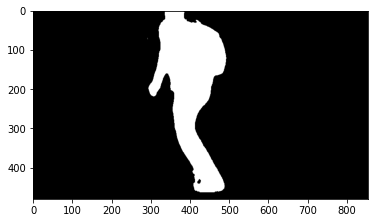

lucia


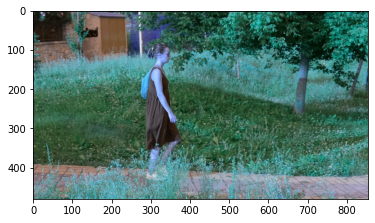

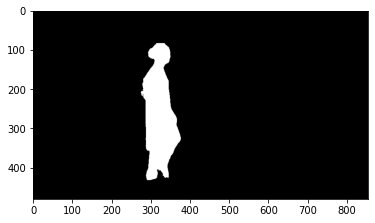

mallard-fly


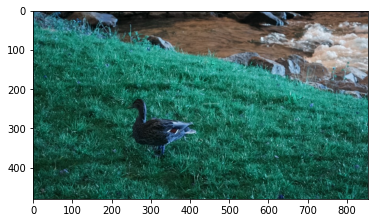

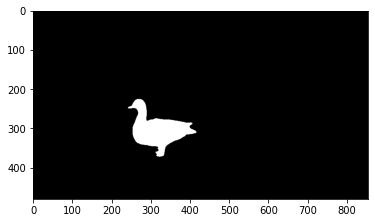

mallard-water


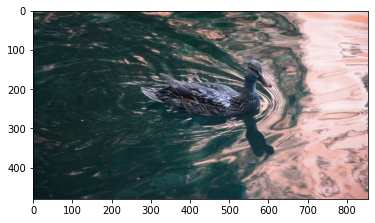

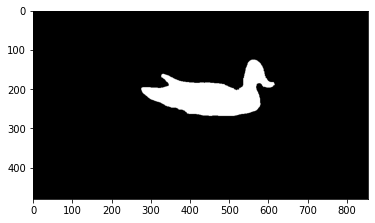

mbike-trick


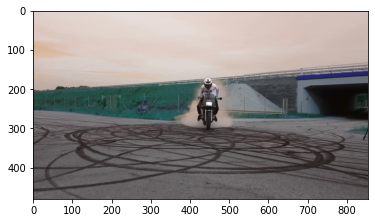

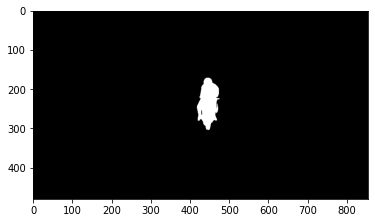

miami-surf


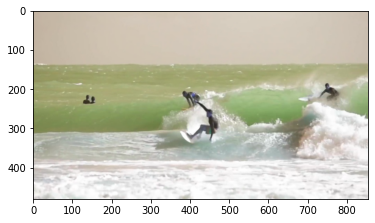

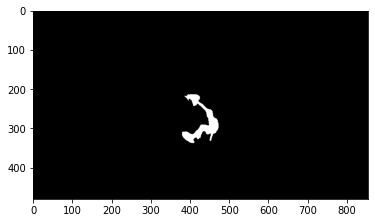

motocross-bumps


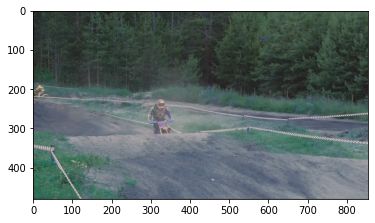

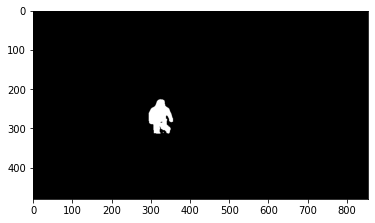

motocross-jump


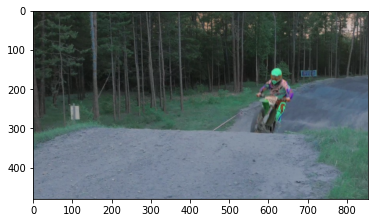

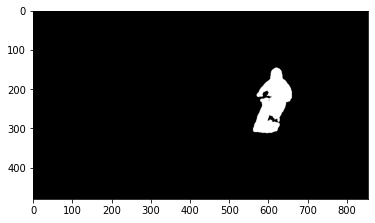

motorbike


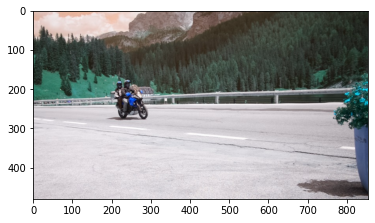

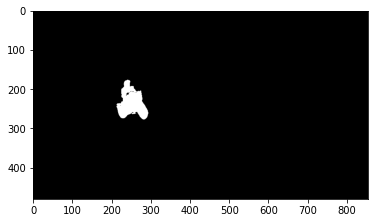

night-race


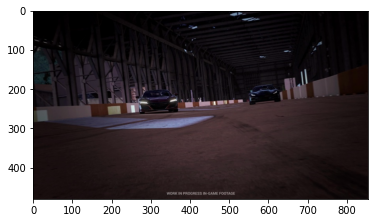

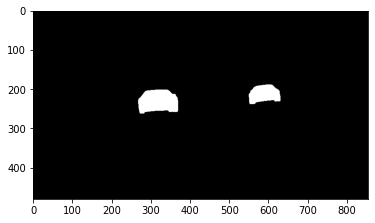

paragliding


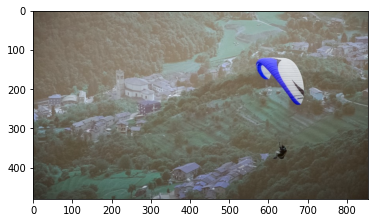

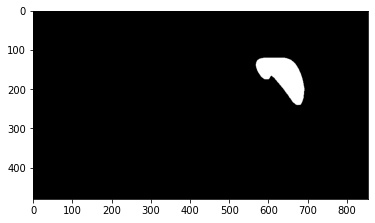

paragliding-launch


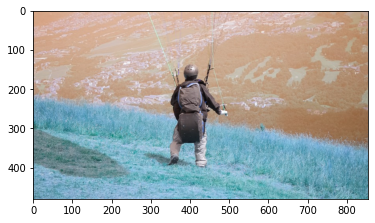

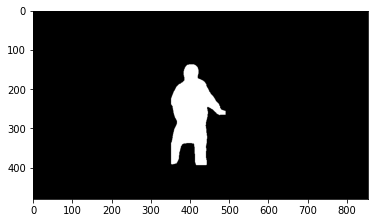

parkour


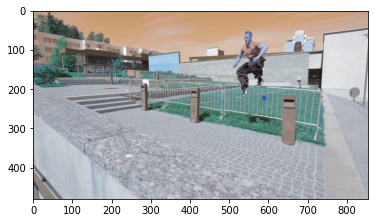

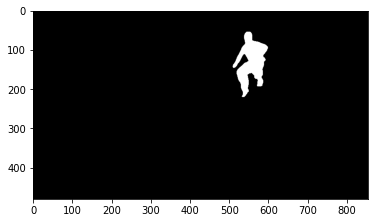

pigs


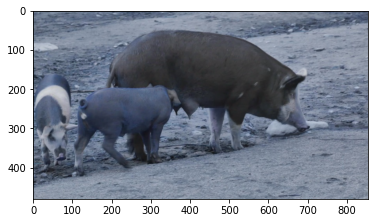

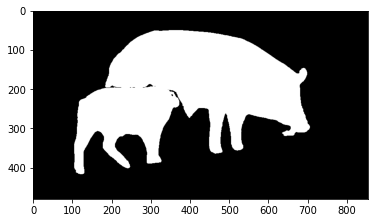

planes-water


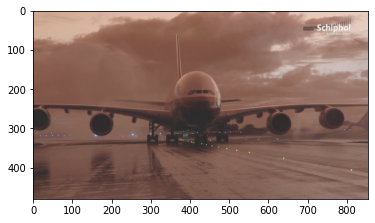

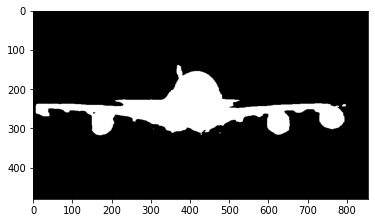

rallye


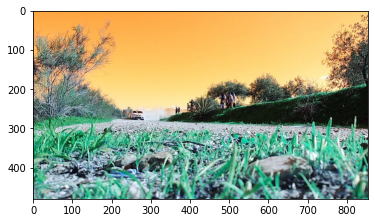

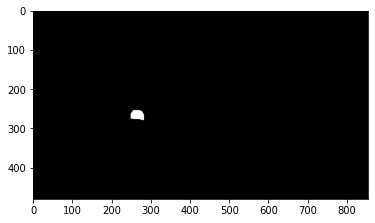

rhino


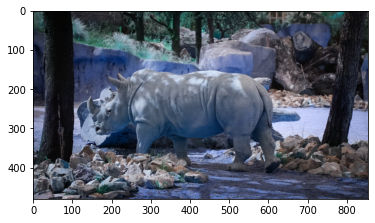

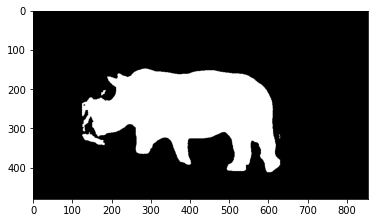

rollerblade


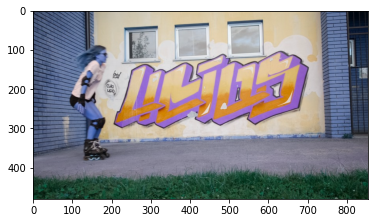

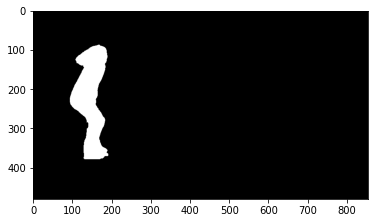

schoolgirls


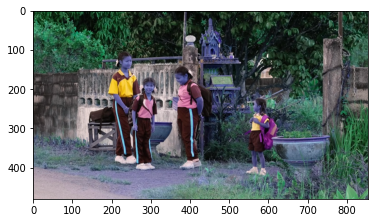

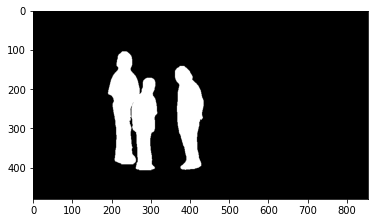

scooter-black


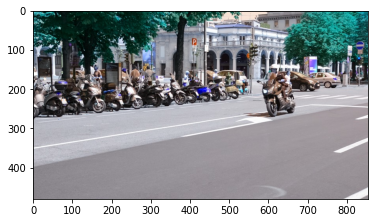

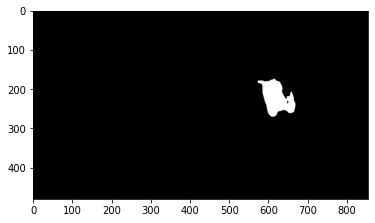

scooter-board


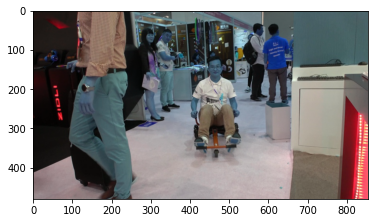

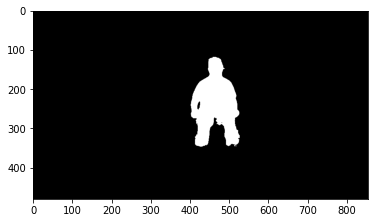

scooter-gray


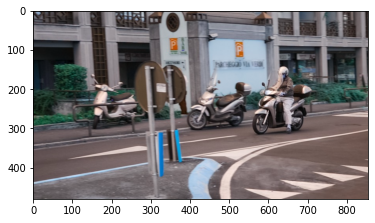

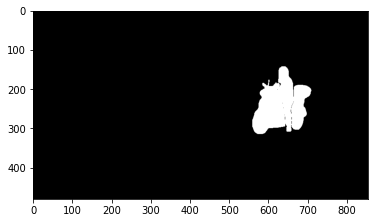

sheep


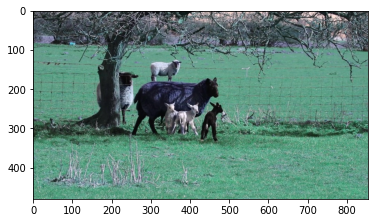

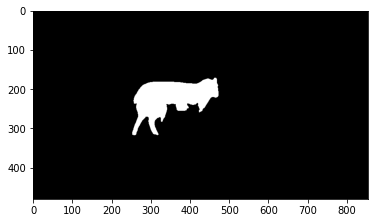

shooting


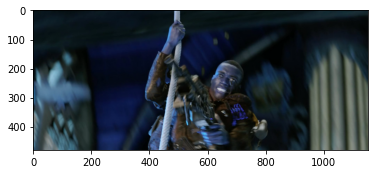

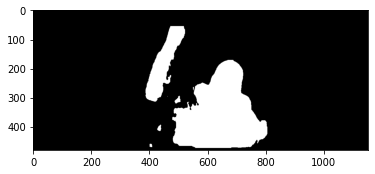

skate-park


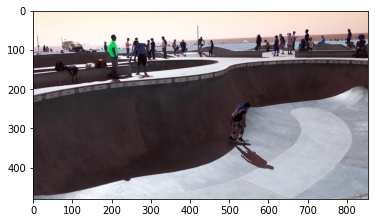

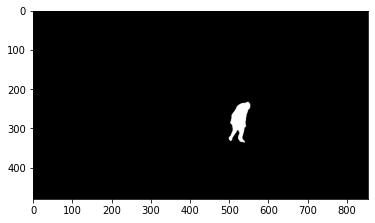

snowboard


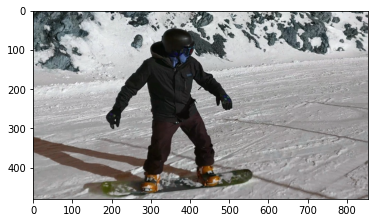

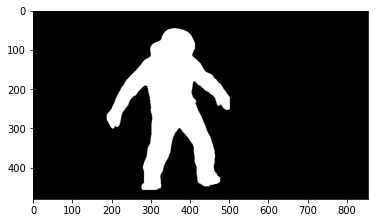

soapbox


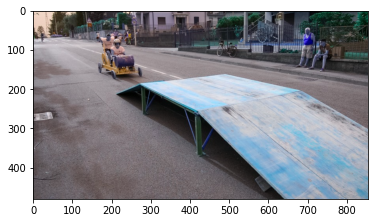

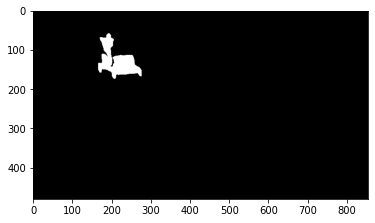

soccerball


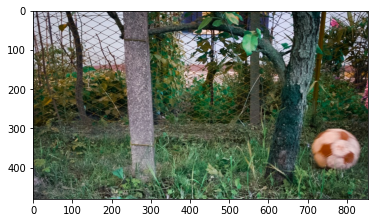

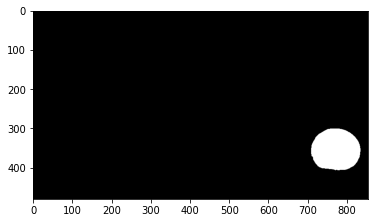

stroller


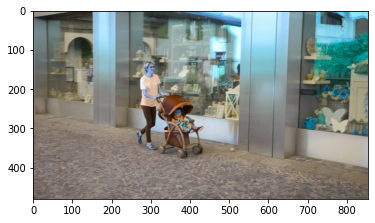

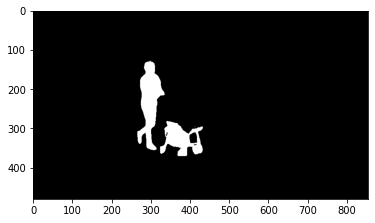

stunt


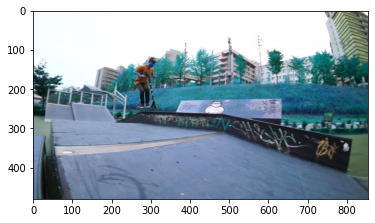

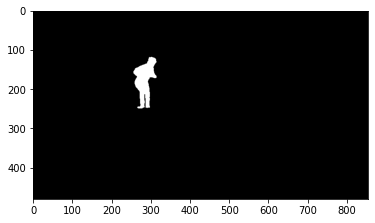

surf


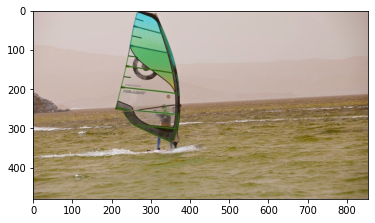

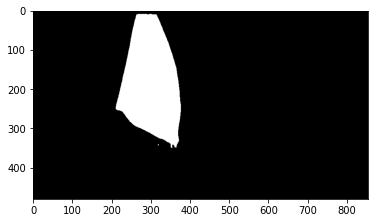

swing


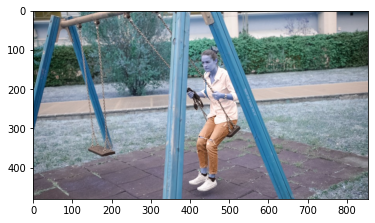

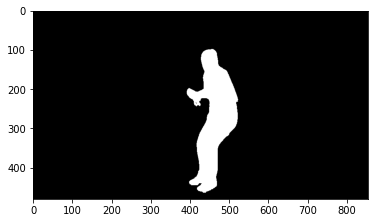

tennis


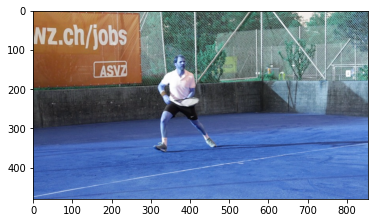

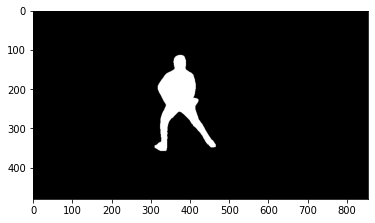

tractor-sand


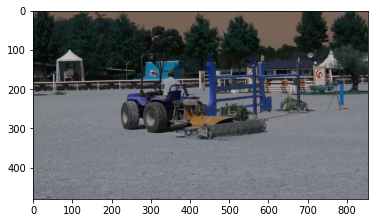

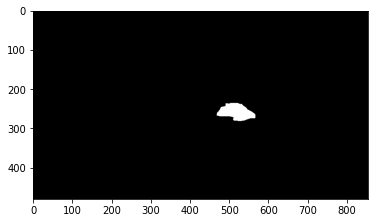

train


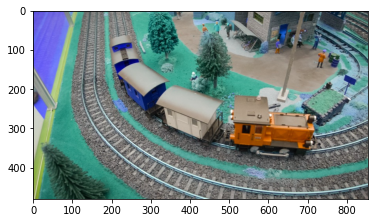

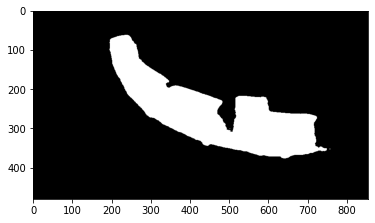

tuk-tuk


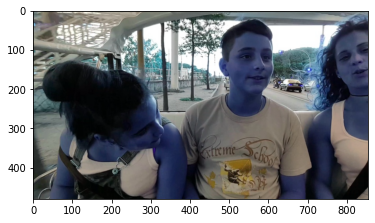

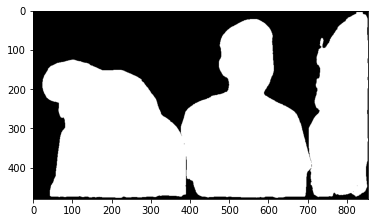

upside-down


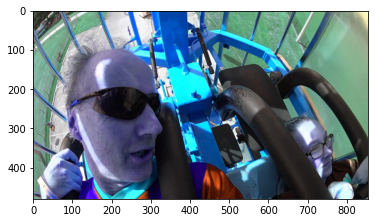

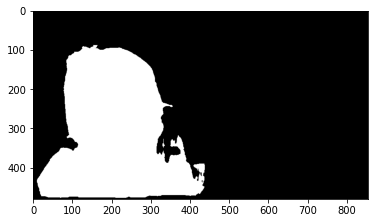

varanus-cage


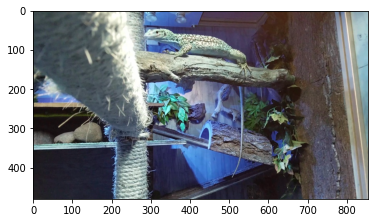

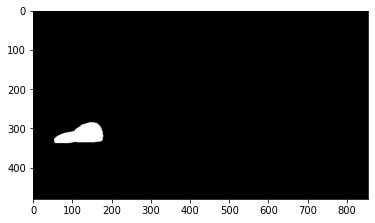

walking


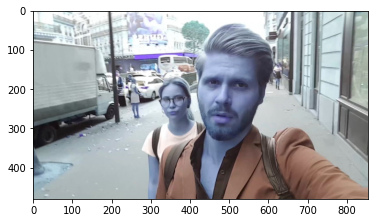

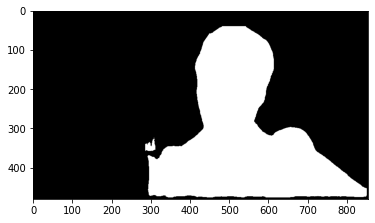

In [40]:
os.chdir('../detectron2_repo')
jpg_first_frame_path = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/JPEGImages/480p'
output_path = '../segmentation_1st_frame_PointRend_corrected'

segment_first_frame(jpg_first_frame_path, output_path, bbox_path ='../bbox_gt', method='PointRend')

In [41]:
if os.path.isdir('../copydavis_pointrend'):
    shutil.rmtree('../copydavis_pointrend')

#Copy Davis directories
shutil.copytree('../../input/davis480dataset','../copydavis_pointrend')

#Remove the ground-truth annotations from copydavis
list_dir = os.listdir('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p')
for video in list_dir:
    shutil.rmtree(os.path.join('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
    

 
#Convert from 1 channel to 3 channels the segmentation produced by Mask-RCNN and save in tmp directory
for video in os.listdir('../segmentation_1st_frame_PointRend_corrected'):
    os.makedirs(os.path.join('temp',video))
    for frame in os.listdir(os.path.join('../segmentation_1st_frame_PointRend_corrected',video)):
        img = Image.open(os.path.join('../segmentation_1st_frame_PointRend_corrected',video,frame)).convert('P')
        img.save(os.path.join('temp',video,frame))
        
#Copy from tmp to copydavis
for video in os.listdir('temp'):
    shutil.copytree(os.path.join('temp', video), os.path.join('../copydavis_pointrend/DAVIS_TRAIN/DAVIS/Annotations/480p',video))
        
#Delete tmp directory    
shutil.rmtree('temp')

#Clone STCN and infer the segmentation for the Davis dataset based on PointRend's first frame segmentation
os.chdir('../STCN')
!python eval_davis.py --output 'out_validation_2017_PointRend_corrected' --davis_path ../copydavis_pointrend/DAVIS_TRAIN/DAVIS/ --model '../../input/loadingsstcn/stcn.pth'                     

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
100% (30 of 30) |########################| Elapsed Time: 0:02:44 Time:  0:02:44
Total pr

In [42]:
data_dir_gt_mask = '../../input/davis480dataset/DAVIS_TRAIN/DAVIS/Annotations/480p'
data_dir_pred_segmentation = '../STCN/out_validation_2017_PointRend_corrected'
list_jaccard_davis, list_f_score_davis, list_j_and_f_davis = compute_scores(data_dir_gt_mask,data_dir_pred_segmentation, list_classes)
print(f'We obtain a J index of {np.mean(list_jaccard_davis) :.2f}, a F index of {np.mean(list_f_score_davis) :.2f} and a J&F index of {np.mean(list_j_and_f_davis) :.2f} on the training set')
      

Jaccard for category pigs : 0.71
F-score for category pigs : 0.82
J&F for category pigs : 0.76


Jaccard for category judo : 0.94
F-score for category judo : 0.97
J&F for category judo : 0.95


Jaccard for category motocross-jump : 0.85
F-score for category motocross-jump : 0.92
J&F for category motocross-jump : 0.88


Jaccard for category drift-chicane : 0.89
F-score for category drift-chicane : 0.94
J&F for category drift-chicane : 0.92


Jaccard for category dog : 0.92
F-score for category dog : 0.96
J&F for category dog : 0.94


Jaccard for category loading : 0.80
F-score for category loading : 0.89
J&F for category loading : 0.84


Jaccard for category india : 0.89
F-score for category india : 0.94
J&F for category india : 0.91


Jaccard for category dogs-jump : 0.66
F-score for category dogs-jump : 0.78
J&F for category dogs-jump : 0.72


Jaccard for category drift-straight : 0.94
F-score for category drift-straight : 0.97
J&F for category drift-straight : 0.95


Jaccard for cate